HOUSING PRICE PREDICTION

Problem Statement:-

Houses are one of the necessary need of each and every person around the globe and therefore housing and real estate market is one of the markets which is one of the major contributors in the world’s economy. It is a very large market and there are various companies working in the domain. Data science comes as a very important tool to solve problems in the domain to help the companies increase their overall revenue, profits, improving their marketing strategies and focusing on changing trends in house sales and purchases. Predictive modelling, Market mix modelling, recommendation systems are some of the machine learning techniques used for achieving the business goals for housing companies. Our problem is related to one such housing company.

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual values and flip them at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia. The data is provided in the CSV file below.

The company is looking at prospective properties to buy houses to enter the market. You are required to build a model using Machine Learning in order to predict the actual value of the prospective properties and decide whether to invest in them or not. For this company wants to know:

• Which variables are important to predict the price of variable?
• How do these variables describe the price of the house?

Business Goal:

You are required to model the price of houses with the available independent variables. This model will then be used by the management to understand how exactly the prices vary with the variables. They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for the management to understand the pricing dynamics of a new market.

Technical Requirements:

• Data contains 1460 entries each having 81 variables.
• Data contains Null values. You need to treat them using the domain knowledge and your own understanding.
• Extensive EDA has to be performed to gain relationships of important variable and price.
• Data contains numerical as well as categorical variable. You need to handle them accordingly.
• You have to build Machine Learning models, apply regularization and determine the optimal values of Hyper
Parameters.
• You need to find important features which affect the price positively or negatively.
• Two datasets are being provided to you (test.csv, train.csv). You will train on train.csv dataset and predict on
test.csv file.

The “Data file.csv” and “Data description.txt” are enclosed with this file.
     

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
path = "/Users/aerryjoop/Desktop/train.csv"

In [3]:
train_df=pd.read_csv(path)

In [4]:
pd.set_option('display.max_rows', 1500)
pd.set_option('display.max_columns', 1500)
pd.set_option('display.width', 1000)
pd.set_option('display.max_rows',None)

In [5]:
train_df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000
5,1197,60,RL,58.0,14054,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,NaN,NaN,NaN,0,11,2006,New,Partial,219210
6,561,20,RL,NaN,11341,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,NaN,NaN,NaN,0,5,2010,WD,Normal,121500
7,1041,20,RL,88.0,13125,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,TA,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,NaN,GdPrv,NaN,0,1,2006,WD,Normal,155000
8,503,20,RL,70.0,9170,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,NaN,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,576,50,RL,80.0,8480,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,442,Unf,0,390,832,Gas

In [6]:
train_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


In [7]:
train_df.head().T

,0,1,2,3,4
Id,127,889,793,110,422
MSSubClass,120,20,60,20,20
MSZoning,RL,RL,RL,RL,RL
LotFrontage,NaN,95.0,92.0,105.0,NaN
LotArea,4928,15865,9920,11751,16635
Street,Pave,Pave,Pave,Pave,Pave
Alley,NaN,NaN,NaN,NaN,NaN
LotShape,IR1,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub


In [8]:
train_df.tail().T

,1163,1164,1165,1166,1167
Id,289,554,196,31,617
MSSubClass,20,20,160,70,60
MSZoning,RL,RL,RL,C (all),RL
LotFrontage,NaN,67.0,24.0,50.0,NaN
LotArea,9819,8777,2280,8500,7861
Street,Pave,Pave,Pave,Pave,Pave
Alley,NaN,NaN,NaN,Pave,NaN
LotShape,IR1,Reg,Reg,Reg,IR1
LandContour,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub


In [9]:
train_df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
  

In [10]:
train_df.shape

(1168, 81)

In [11]:
train_df.drop_duplicates(inplace=True)

In [12]:
train_df.shape

(1168, 81)

In [13]:
train_df.nunique().to_frame("Numbers of unique values")

,Numbers of unique values
Id,1168
MSSubClass,15
MSZoning,5
LotFrontage,106
LotArea,892
Street,2
Alley,2
LotShape,4
LandContour,4
Utilities,1


In [14]:
train_df.drop(['Id', 'Utilities'],axis=1,inplace=True)

In [15]:
train_df.isnull().sum()

MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFinSF        0
GrLivArea           0
BsmtFullBa

In [16]:
train_df.isnull().sum().sum()

5558

<function matplotlib.pyplot.show(close=None, block=None)>

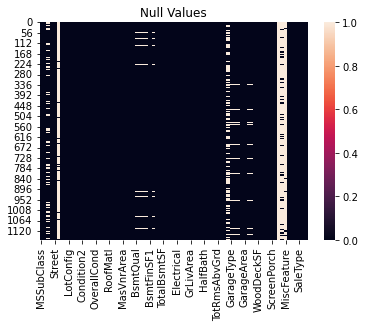

In [17]:
sns.heatmap(train_df.isnull())
plt.title("Null Values")
plt.show

In [18]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1168 entries, 0 to 1167
Data columns (total 79 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1168 non-null   int64  
 1   MSZoning       1168 non-null   object 
 2   LotFrontage    954 non-null    float64
 3   LotArea        1168 non-null   int64  
 4   Street         1168 non-null   object 
 5   Alley          77 non-null     object 
 6   LotShape       1168 non-null   object 
 7   LandContour    1168 non-null   object 
 8   LotConfig      1168 non-null   object 
 9   LandSlope      1168 non-null   object 
 10  Neighborhood   1168 non-null   object 
 11  Condition1     1168 non-null   object 
 12  Condition2     1168 non-null   object 
 13  BldgType       1168 non-null   object 
 14  HouseStyle     1168 non-null   object 
 15  OverallQual    1168 non-null   int64  
 16  OverallCond    1168 non-null   int64  
 17  YearBuilt      1168 non-null   int64  
 18  YearRemo

In [19]:
train_df.dtypes

MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object
HeatingQC         object
CentralAir        object


In [20]:
train_df['LotFrontage'] = train_df['LotFrontage'].fillna(train_df['LotFrontage'].mean())
train_df['Alley'] = train_df['Alley'].fillna(train_df['Alley'].mode()[0])
train_df['MasVnrType'] = train_df['MasVnrType'].fillna(train_df['MasVnrType'].mode()[0])
train_df['MasVnrArea'] = train_df['MasVnrArea'].fillna(train_df['MasVnrArea'].mean())
train_df['BsmtQual'] = train_df['BsmtQual'].fillna(train_df['BsmtQual'].mode()[0])
train_df['BsmtCond'] = train_df['BsmtCond'].fillna(train_df['BsmtCond'].mode()[0])
train_df['BsmtExposure'] = train_df['BsmtExposure'].fillna(train_df['BsmtExposure'].mode()[0])
train_df['BsmtFinType1'] = train_df['BsmtFinType1'].fillna(train_df['BsmtFinType1'].mode()[0])
train_df['BsmtFinType2'] = train_df['BsmtFinType2'].fillna(train_df['BsmtFinType2'].mode()[0])
train_df['FireplaceQu'] = train_df['FireplaceQu'].fillna(train_df['FireplaceQu'].mode()[0])
train_df['GarageType'] = train_df['GarageType'].fillna(train_df['GarageType'].mode()[0])
train_df['GarageYrBlt'] = train_df['GarageYrBlt'].fillna(train_df['GarageYrBlt'].mean())
train_df['GarageFinish'] = train_df['GarageFinish'].fillna(train_df['GarageFinish'].mode()[0])
train_df['GarageQual'] = train_df['GarageQual'].fillna(train_df['GarageQual'].mode()[0])
train_df['GarageCond'] = train_df['GarageCond'].fillna(train_df['GarageCond'].mode()[0])
train_df['PoolQC'] = train_df['PoolQC'].fillna(train_df['PoolQC'].mode()[0])
train_df['Fence'] = train_df['Fence'].fillna(train_df['Fence'].mode()[0])
train_df['MiscFeature'] = train_df['MiscFeature'].fillna(train_df['MiscFeature'].mode()[0])

In [21]:
train_df.isnull().sum().sum()

0

<function matplotlib.pyplot.show(close=None, block=None)>

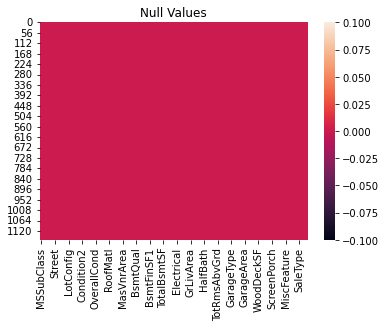

In [22]:
sns.heatmap(train_df.isnull())
plt.title("Null Values")
plt.show

In [23]:
train_df.shape

(1168, 79)

In [24]:
train_df.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,56.767979,70.988470,10484.749144,6.104452,5.595890,1970.930651,1984.758562,102.310078,444.726027,46.647260,569.721747,1061.095034,1169.860445,348.826199,6.380137,1525.066781,0.425514,0.055651,1.562500,0.388699,2.884418,1.045377,6.542808,0.617295,1978.193841,1.776541,476.860445,96.206336,46.559932,23.015411,3.639555,15.051370,3.448630,47.315068,6.344178,2007.804795,181477.005993
std,41.940650,22.437056,8957.442311,1.390153,1.124343,30.145255,20.785185,182.047152,462.664785,163.520016,449.375525,442.272249,391.161983,439.696370,50.892844,528.042957,0.521615,0.236699,0.551882,0.504929,0.817229,0.216292,1.598484,0.650575,24.198559,0.745554,214.466769,126.158988,66.381023,63.191089,29.088867,55.080816,44.896939,543.264432,2.686352,1.329738,79105.586863
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1875.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,20.000000,60.000000,7621.500000,5.000000,5.000000,1954.000000,1966.000000,0.000000,0.000000,0.000000,216.000000,799.000000,892.000000,0.000000,0.000000,1143.250000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1962.000000,1.000000,338.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,130375.000000
50%,50.000000,70.988470,9522.500000,6.000000,5.000000,1972.000000,1993.000000,0.000000,385.500000,0.000000,474.000000,1005.500000,1096.500000,0.000000,0.000000,1468.500000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1978.193841,2.000000,480.000000,0.000000,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163995.000000
75%,70.000000,79.250000,11515.500000,7.000000,6.000000,2000.000000,2004.000000,160.000000,714.500000,0.000000,816.000000,1291.500000,1392.000000,729.000000,0.000000,1795.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2001.000000,2.000000,576.000000,171.000000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,215000.000000
max,190.000000,313.000000,164660.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [25]:
for i in train_df.columns:
        print(train_df[i].value_counts())
        print('___________'*10)

20     428
60     244
50     113
120     69
70      53
30      52
160     47
80      43
90      41
190     26
85      19
75      14
45      10
180      6
40       3
Name: MSSubClass, dtype: int64
______________________________________________________________________________________________________________
RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64
______________________________________________________________________________________________________________
70.98847     214
60.00000     111
80.00000      60
70.00000      58
75.00000      46
50.00000      44
65.00000      35
85.00000      26
90.00000      20
78.00000      19
24.00000      16
68.00000      16
73.00000      16
64.00000      14
79.00000      14
21.00000      14
51.00000      13
55.00000      13
72.00000      13
100.00000     12
59.00000      12
82.00000      12
63.00000      11
71.00000      11
74.00000      11
88.00000      10
66.00000      10
69.00000      10
53

In [26]:
train_df_cc=[]
for i in train_df.dtypes.index:
    if train_df.dtypes[i]=='object':
        train_df_cc.append(i)
print(train_df_cc)

['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition']


In [27]:
len(train_df_cc)

42

In [28]:
train_df_nc=[]
for i in train_df.dtypes.index:
    if train_df.dtypes[i]!='object':
        train_df_nc.append(i)
print(train_df_nc)

['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice']


In [29]:
len(train_df_nc)

37

In [30]:
len(train_df.dtypes.index)==len(train_df_cc)+len(train_df_nc)

True

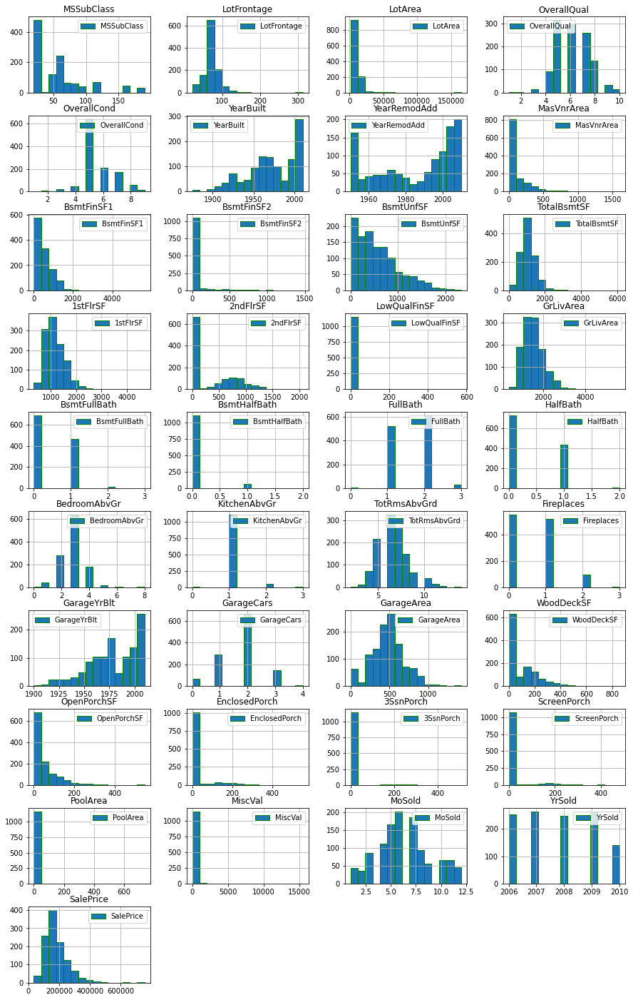

In [31]:
train_df.hist(figsize=(15,30),edgecolor='green',layout=(12,4),bins=15,legend=True)
plt.show()

20     428
60     244
50     113
120     69
70      53
30      52
160     47
80      43
90      41
190     26
85      19
75      14
45      10
180      6
40       3
Name: MSSubClass, dtype: int64


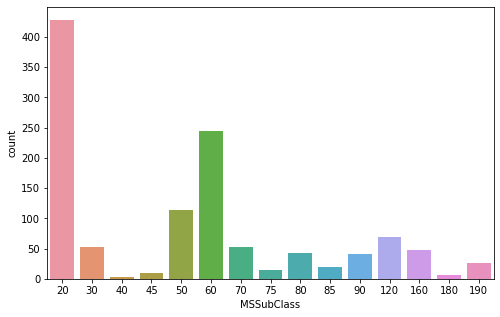

In [32]:
plt.figure(figsize=(8,5))
ax = sns.countplot(x='MSSubClass',data=train_df)
print(train_df['MSSubClass'].value_counts())

Pave    1164
Grvl       4
Name: Street, dtype: int64


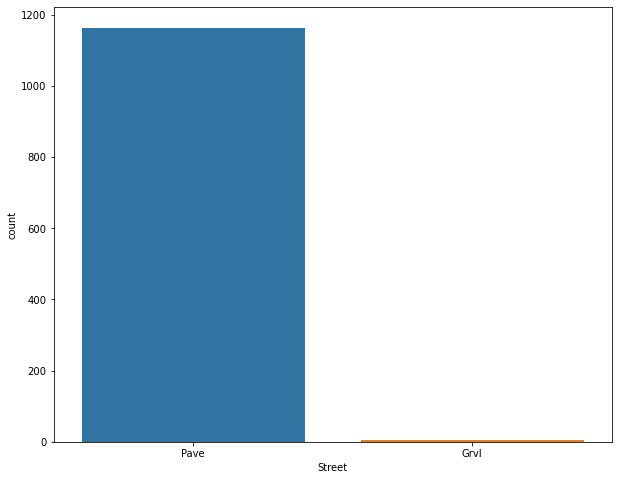

In [33]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="Street",data=train_df)
print(train_df["Street"].value_counts())

Grvl    1132
Pave      36
Name: Alley, dtype: int64


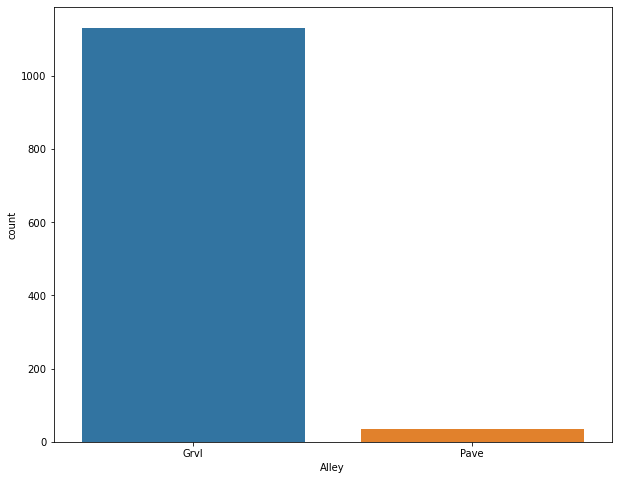

In [34]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="Alley",data=train_df)
print(train_df["Alley"].value_counts())

Gtl    1105
Mod      51
Sev      12
Name: LandSlope, dtype: int64


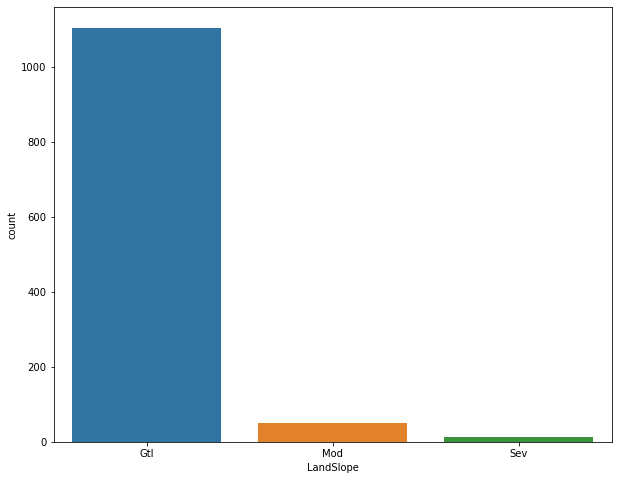

In [35]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="LandSlope",data=train_df)
print(train_df["LandSlope"].value_counts())

Reg    740
IR1    390
IR2     32
IR3      6
Name: LotShape, dtype: int64


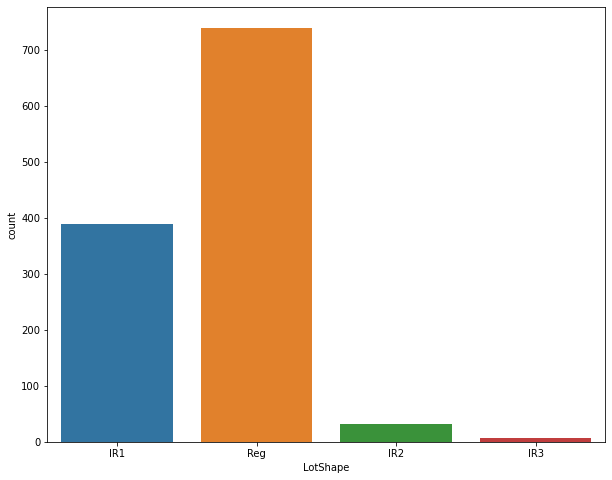

In [36]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="LotShape",data=train_df)
print(train_df["LotShape"].value_counts())

Lvl    1046
Bnk      50
HLS      42
Low      30
Name: LandContour, dtype: int64


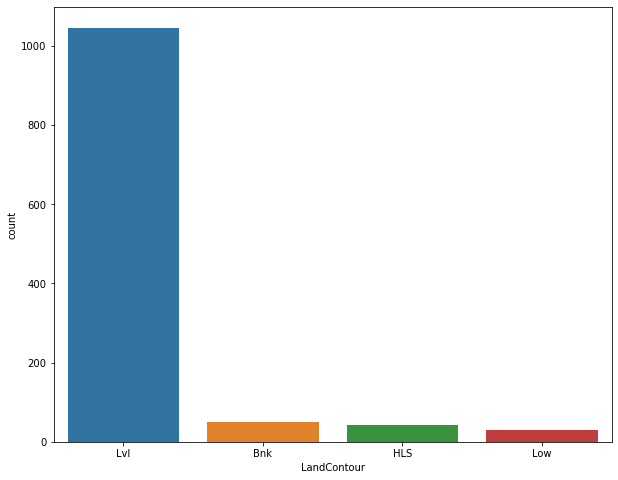

In [37]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="LandContour",data=train_df)
print(train_df["LandContour"].value_counts())

Inside     842
Corner     222
CulDSac     69
FR2         33
FR3          2
Name: LotConfig, dtype: int64


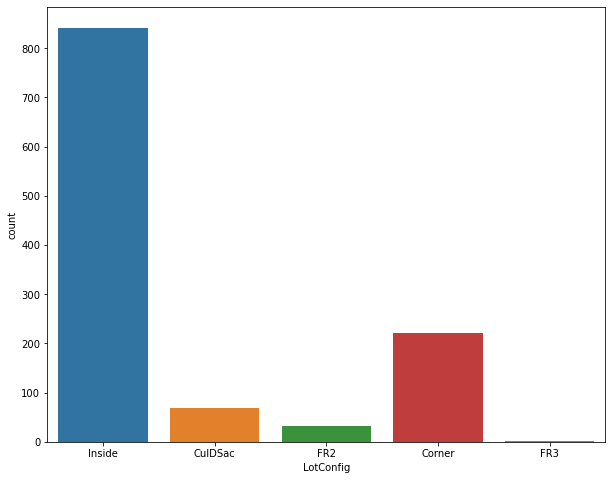

In [38]:
plt.figure(figsize=(10,8))
ax = sns.countplot(x="LotConfig",data=train_df)
print(train_df["LotConfig"].value_counts())

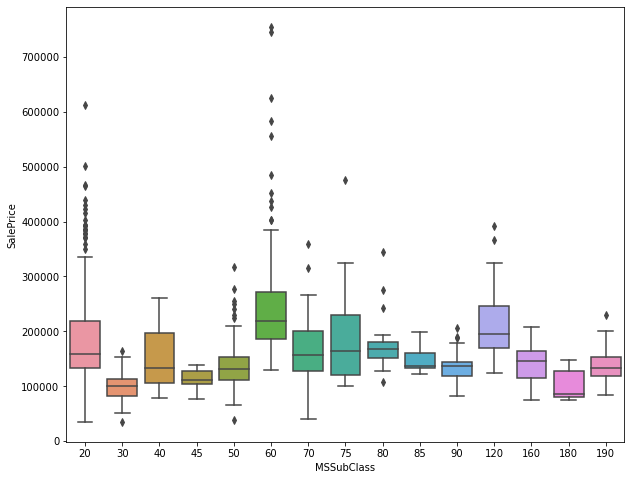

In [39]:
plt.figure(figsize=(10,8))
sns.boxplot(x='MSSubClass',y='SalePrice',data=train_df.sort_values('SalePrice',ascending=False))
plt.show()

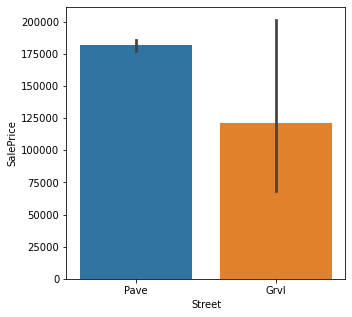

In [40]:
plt.figure(figsize=[5,5])
sns.barplot(x='Street', y='SalePrice', data = train_df.sort_values('SalePrice', ascending=False))
plt.show()

<Figure size 576x432 with 0 Axes>

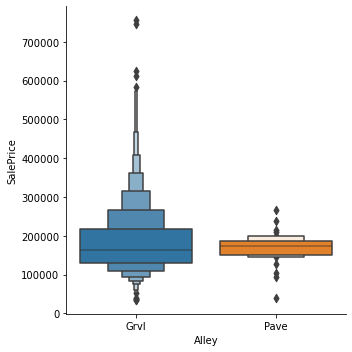

In [41]:
plt.figure(figsize=[8,6])
sns.catplot(x='Alley', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False), kind = 'boxen')
plt.show()

<Figure size 576x288 with 0 Axes>

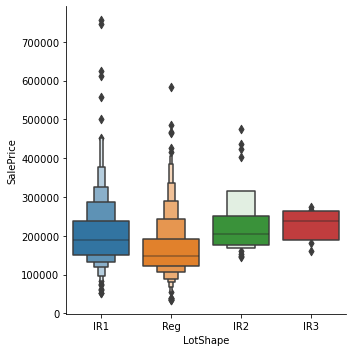

In [42]:
plt.figure(figsize=[8,4])
sns.catplot(x='LotShape', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False), kind = 'boxen')
plt.show()

<Figure size 576x288 with 0 Axes>

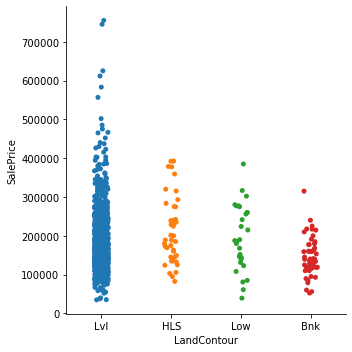

In [43]:
plt.figure(figsize=[8,4])
sns.catplot(x='LandContour', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False))
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

<Figure size 432x288 with 0 Axes>

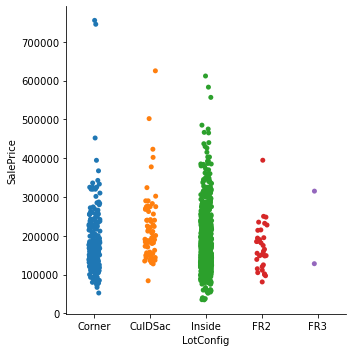

In [44]:
plt.figure(figsize=[6,4])
sns.catplot(x='LotConfig', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False))
plt.show

<Figure size 576x432 with 0 Axes>

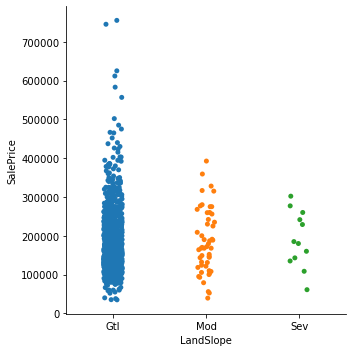

In [45]:
plt.figure(figsize=[8,6])
sns.catplot(x='LandSlope', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False))
plt.show()

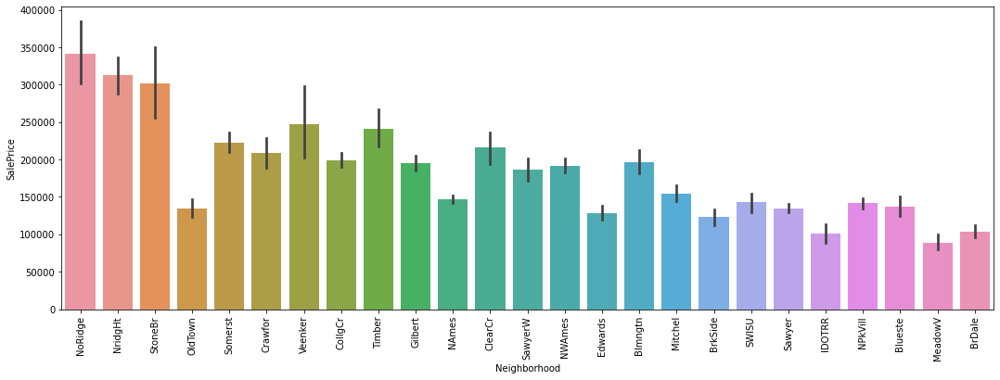

In [46]:
plt.figure(figsize=[18,6])
sns.barplot(x='Neighborhood', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False))
plt.xticks(rotation=90)
plt.show()

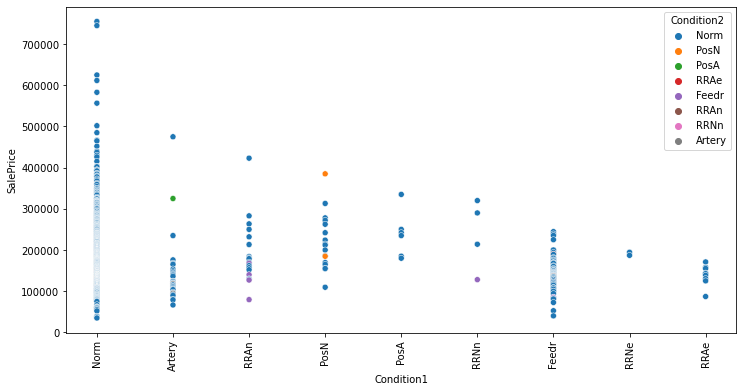

In [47]:
plt.figure(figsize=[12,6])
sns.scatterplot(x='Condition1', y='SalePrice', hue='Condition2', data=train_df.sort_values('SalePrice', ascending=False))
plt.xticks(rotation=90)
plt.show()

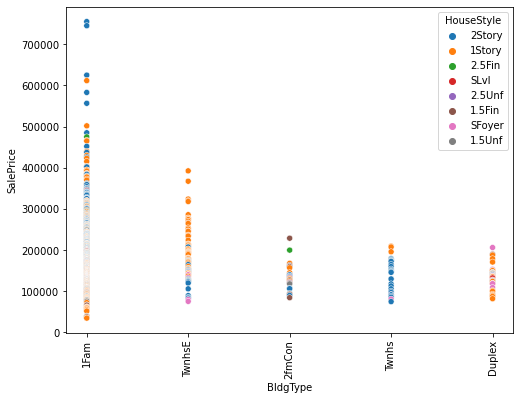

In [48]:
plt.figure(figsize=[8,6])
sns.scatterplot(x= 'BldgType', y='SalePrice', hue = 'HouseStyle', data=train_df.sort_values('SalePrice', ascending=False))
plt.xticks(rotation = 90)
plt.show()

<Figure size 576x432 with 0 Axes>

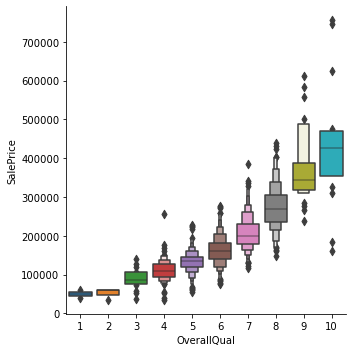

In [49]:
plt.figure(figsize=[8,6])
sns.catplot(x='OverallQual', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False), kind = 'boxen')
plt.show()

<Figure size 576x432 with 0 Axes>

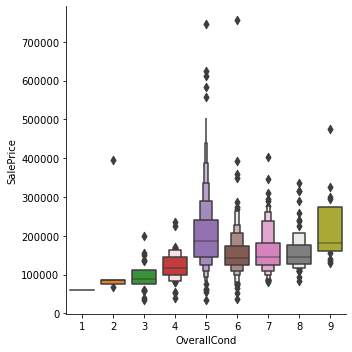

In [50]:
plt.figure(figsize=[8,6])
sns.catplot(x='OverallCond', y='SalePrice', data=train_df.sort_values('SalePrice', ascending=False), kind = 'boxen')
plt.show()

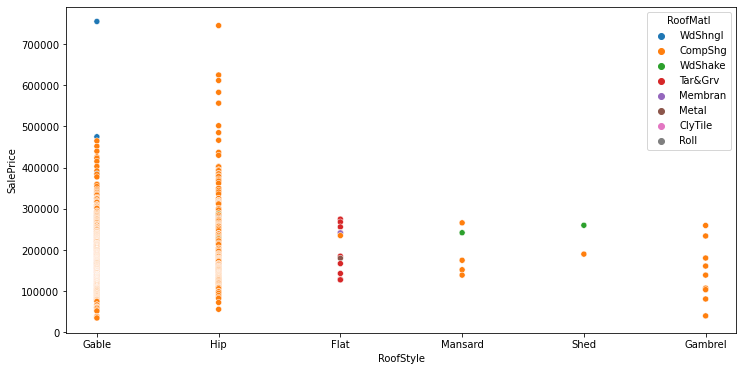

In [51]:
plt.figure(figsize=[12,6])
sns.scatterplot(x='RoofStyle', y='SalePrice', hue = 'RoofMatl', data=train_df.sort_values('SalePrice', ascending=False))
plt.show()

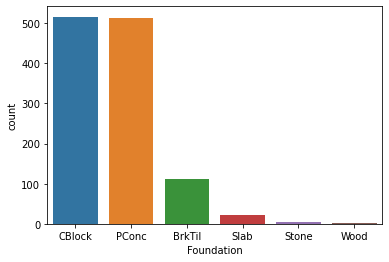

In [52]:
plt.figure(figsize=[6,4])
sns.countplot(x='Foundation', data=train_df)
plt.show()

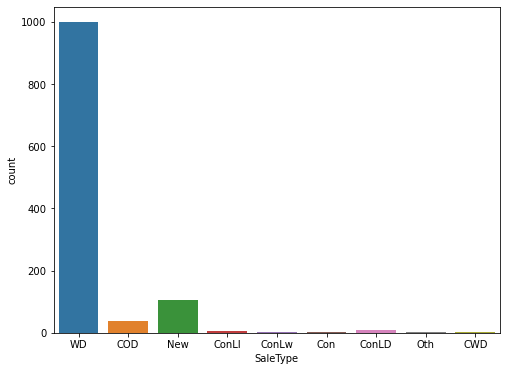

In [53]:
plt.figure(figsize=[8,6])
sns.countplot(train_df['SaleType'])
plt.show()

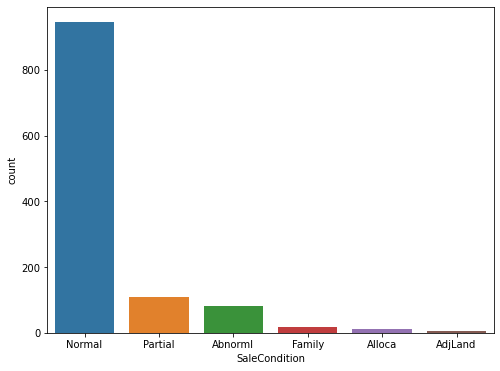

In [54]:
plt.figure(figsize=[8,6])
sns.countplot(train_df['SaleCondition'])
plt.show()

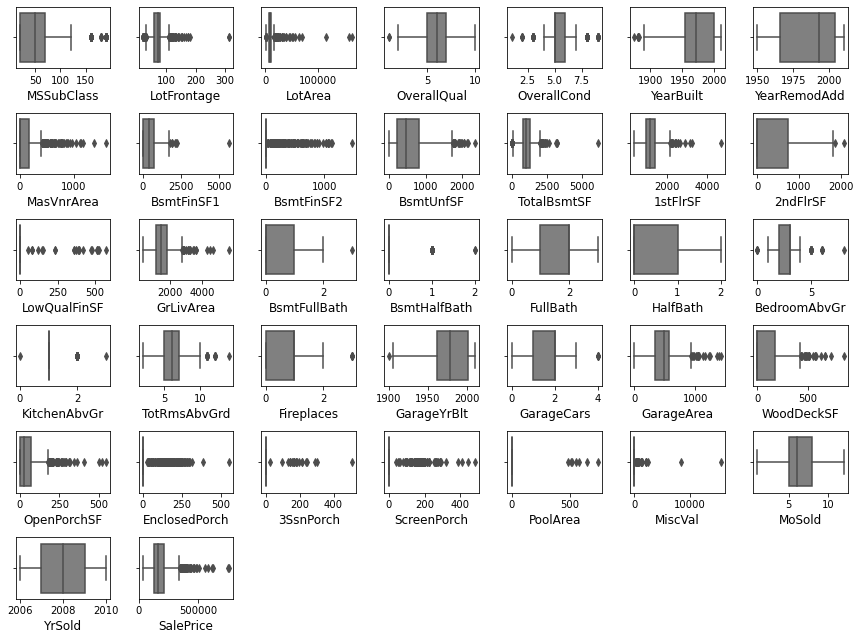

In [55]:
plt.figure(figsize=(12,10),facecolor='white')
plotnumber=1
for column in train_df_nc:
    if plotnumber<=37:
        ax=plt.subplot(7,7,plotnumber)
        sns.boxplot(train_df[column],color='gray')
        plt.xlabel(column,fontsize=12)
    plotnumber+=1
plt.tight_layout()

In [56]:
len(train_df_nc)

37

In [57]:
f = train_df[['MSSubClass', 'LotFrontage', 'LotArea','OverallQual', 'OverallCond' ,'YearBuilt', 'MasVnrArea', 'BsmtFinSF1','BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF','LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BedroomAbvGr','KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch', 'ScreenPorch','PoolArea','MiscVal', 'SalePrice']]

In [58]:
from scipy.stats import zscore
z=np.abs(zscore(f))
z

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,SalePrice
0,1.508301,0.000000,0.620616,0.075169,0.530217,0.168236,0.562238,0.702161,0.285392,0.864410,0.038239,0.541850,0.793674,0.125418,1.074363,0.816112,1.082679,0.209883,0.965583,0.588509,0.049356,0.299850,0.171944,0.762907,2.387850,0.364375,0.125172,0.273377,0.076845,0.087131,0.676310
1,0.877042,1.070631,0.600903,1.364138,0.359572,0.030885,0.562238,0.202665,4.749787,1.053642,2.614679,2.678144,0.793674,0.125418,1.310934,1.101833,1.365664,0.209883,0.911999,0.588509,0.338754,0.299850,0.672371,0.120585,2.417992,0.364375,0.125172,3.795117,0.076845,0.087131,1.094234
2,0.077095,0.936867,0.063075,0.644484,0.530217,0.831975,0.562238,0.902279,0.285392,0.700654,0.126458,0.109619,1.222216,0.125418,0.924437,1.101833,0.141492,0.209883,0.911999,0.588509,0.777493,0.299850,0.101973,0.664476,1.257525,0.364375,0.125172,0.273377,0.076845,0.087131,1.116872
3,0.877042,1.516514,0.141424,0.075169,0.359572,0.201423,2.075571,0.562795,0.285392,1.267363,1.770946,1.724166,0.793674,0.125418,0.604250,0.816112,0.141492,0.209883,0.286138,0.588509,0.049356,0.299850,0.322517,0.762907,1.136957,0.364375,0.125172,0.273377,0.076845,0.087131,0.107788
4,0.877042,0.000000,0.686902,0.075169,1.249361,0.201423,0.130186,1.732609,0.285392,0.475801,1.223537,1.105232,0.793674,0.125418,0.145757,0.816112,0.141492,0.209883,0.911999,0.588509,0.049356,0.299850,0.243217,1.140270,0.701705,0.364375,0.125172,0.273377,0.076845,0.087131,0.423957
5,0.077095,0.579133,0.398638,0.644484,0.530217,1.163844,0.562238,0.961639,0.285392,0.688535,0.411902,0.743899,1.445192,0.125418,0.640247,0.816112,1.365664,0.209883,1.537860,0.588509,1.149575,1.641710,0.854296,0.030083,0.445498,0.364375,0.125172,0.273377,0.076845,0.087131,0.477200
6,0.877042,0.000000,0.095632,0.794823,0.359572,0.462315,0.426940,1.853699,0.285392,1.067987,0.748513,0.568140,0.793674,0.125418,0.252108,1.101833,0.141492,0.209883,0.965583,0.588509,0.876206,0.299850,0.238552,0.762907,0.701705,0.364375,0.125172,1.452100,0.076845,0.087131,0.758514
7,0.877042,0.758514,0.294881,0.794823,1.420006,0.462315,0.194044,0.598370,3.887138,0.636092,0.164912,1.619306,0.793674,0.125418,0.526571,1.101833,0.141492,0.209883,0.911999,0.588509,0.876206,0.299850,0.033304,0.762907,0.701705,0.364375,0.125172,0.273377,0.076845,0.087131,0.334848
8,0.877042,0.044074,0.146840,0.794823,1.249361,0.196820,0.562238,0.547659,0.301944,0.333320,0.345874,0.112890,0.793674,0.125418,0.589346,1.101833,1.082679,0.209883,0.339722,0.949251,0.545466,0.299850,0.073985,0.762907,0.701705,2.548675,0.125172,0.273377,0.076845,0.649474,0.524549
9,0.161440,0.401808,0.223904,0.794823,0.530217,0.794185,0.562238,0.005895,0.285392,0.400108,0.518217,0.864105,0.080030,0.125418,0.585557,0.816112,1.082679,0.209883,0.339722,0.949251,1.289631,1.042009,0.657075,0.490018,0.701705,1.250468,0.125172,0.273377,0.076845,0.087131,0.796454


In [59]:
threshold=3
print(np.where(z>3))

(array([   1,    1,    7,   14,   20,   22,   23,   25,   27,   32,   32,
         32,   33,   38,   40,   47,   48,   51,   51,   63,   66,   66,
         68,   68,   72,   72,   73,   74,   76,   77,   78,   91,   93,
         93,   95,   96,   97,   98,  103,  103,  103,  103,  103,  103,
        103,  106,  106,  107,  112,  113,  115,  119,  119,  119,  119,
        127,  127,  133,  138,  138,  140,  141,  141,  141,  141,  141,
        141,  141,  141,  142,  142,  143,  150,  151,  152,  153,  156,
        157,  166,  170,  178,  178,  184,  191,  192,  192,  192,  192,
        195,  196,  206,  210,  210,  211,  211,  212,  214,  216,  226,
        228,  232,  232,  232,  232,  237,  241,  241,  241,  241,  243,
        245,  245,  253,  254,  255,  259,  269,  272,  273,  284,  284,
        289,  299,  299,  300,  303,  304,  305,  305,  305,  305,  305,
        305,  308,  309,  310,  310,  312,  319,  320,  325,  333,  335,
        338,  338,  352,  352,  355,  356,  357,  

In [60]:
train_df1 = train_df[(z<3).all(axis=1)] 
train_df1

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,70.98847,4928,Pave,Grvl,IR1,Lvl,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.000000,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.000000,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,Gd,MnPrv,Shed,0,2,2007,WD,Normal,128000
2,60,RL,92.00000,9920,Pave,Grvl,IR1,Lvl,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.000000,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.000000,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,Gd,MnPrv,Shed,0,6,2007,WD,Normal,269790
3,20,RL,105.00000,11751,Pave,Grvl,IR1,Lvl,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.000000,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.000000,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,Gd,MnPrv,Shed,0,1,2010,COD,Normal,190000
4,20,RL,70.98847,16635,Pave,Grvl,IR1,Lvl,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.000000,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.000000,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,Gd,MnPrv,Shed,0,6,2009,WD,Normal,215000
5,60,RL,58.00000,14054,Pave,Grvl,IR1,Lvl,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.000000,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.000000,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,Gd,MnPrv,Shed,0,11,2006,New,Partial,219210
6,20,RL,70.98847,11341,Pave,Grvl,IR1,Lvl,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.000000,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.000000,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,Gd,MnPrv,Shed,0,5,2010,WD,Normal,121500
8,20,RL,70.00000,9170,Pave,Grvl,Reg,Lvl,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,Gd,Detchd,1965.000000,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,Gd,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,50,RL,80.00000,8480,Pave,Grvl,Reg,Lvl,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,CBlock,TA,TA,No,Rec,442,Unf,0,390,832,GasA,TA,Y,SBrkr,832,384,0,1216,0,0,1,0,2,1,TA,6,Typ,0,Gd,Detchd,1947.000000,Unf,1,336,TA,TA,Y,158,0,102,0,0,0,Gd,MnPrv,Shed,0,10,2008,COD,Abnorml,118500
10,50,RM,50.00000,8600,Pave,Grvl,Reg,Bnk,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1.5Fin,6,6,1937,1950,Gable,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,780,780,GasA,TA,Y,SBrkr,780,596,0,1376,0,0,2,0,3,1,TA,7,Typ,1,Gd,Detchd,1937.000000,Unf,1,198,TA,TA,N,0,0,0,0,0,0,Gd,MnPrv,Shed,0,6,2006,WD,Normal,119500
11,60,RL,44.00000,9548,Pave,Grvl,IR1,Lvl,CulDSac,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,6,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,223.000000,Gd,TA,PConc,Gd

In [61]:
train_df.shape

(1168, 79)

In [62]:
train_df1.shape

(847, 79)

In [63]:
data_loss=((1168-847)/1168)*100

In [64]:
data_loss

27.482876712328768

In [65]:
# Removing outliers in train data using percentile method 
for col in f:
    if train_df[col].dtypes != 'object':
        percentile = train_df[col].quantile([0.01,0.98]).values
        train_df[col][train_df[col]<=percentile[0]]=percentile[0]
        train_df[col][train_df[col]>=percentile[1]]=percentile[1]   

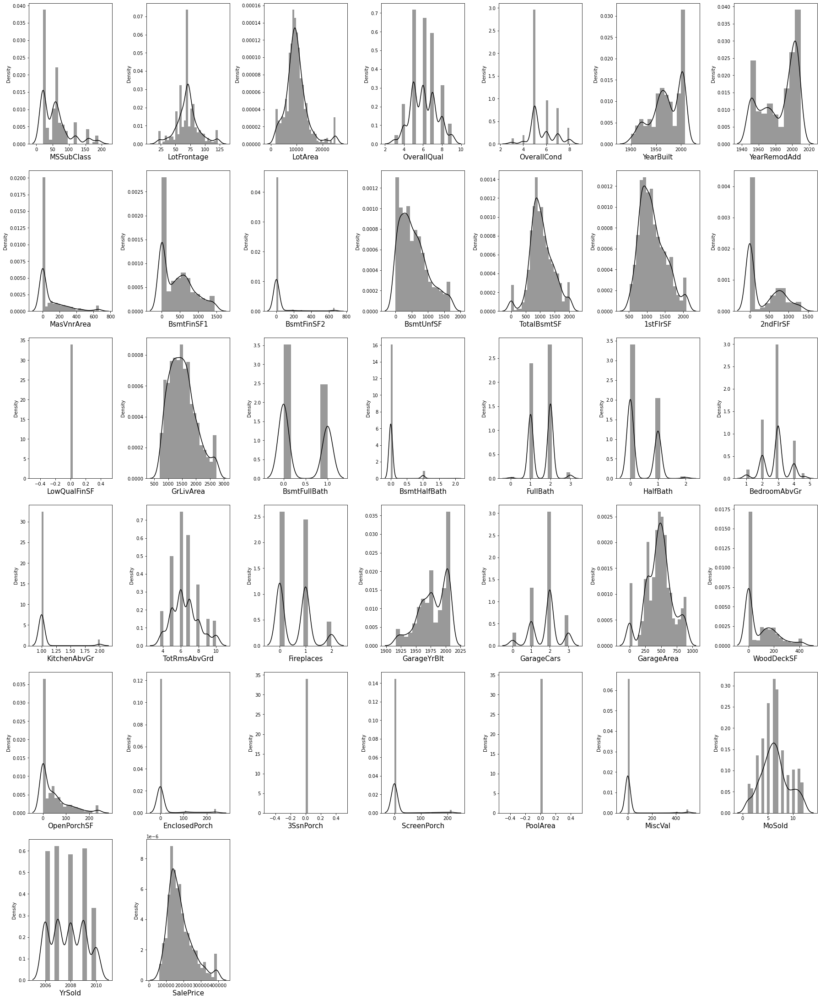

In [66]:
plt.figure(figsize=(25,35),facecolor='white')
plotnumber = 1
for column in train_df_nc:
    if plotnumber<=37:
        ax = plt.subplot(7,7,plotnumber)
        sns.distplot(train_df[column], color='black')
        plt.xlabel(column, fontsize = 15)
    plotnumber+=1
plt.tight_layout()

In [67]:
len(train_df_nc)

37

In [68]:
train_df.skew().to_frame("Check skewness present in features")

,Check skewness present in features
MSSubClass,1.422019
LotFrontage,0.188060
LotArea,1.191912
OverallQual,0.139627
OverallCond,0.565815
YearBuilt,-0.519847
YearRemodAdd,-0.495864
MasVnrArea,1.873138
BsmtFinSF1,0.639523
BsmtFinSF2,3.543134


In [69]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
MiscVal,5.131980
KitchenAbvGr,4.374289
BsmtHalfBath,4.264403
BsmtFinSF2,3.543134
ScreenPorch,3.381627
EnclosedPorch,2.623505
MasVnrArea,1.873138
OpenPorchSF,1.513678
MSSubClass,1.422019
LotArea,1.191912


In [70]:
train_df.drop(['3SsnPorch', 'PoolArea', 'LowQualFinSF'],axis=1,inplace=True)

In [71]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
MiscVal,5.131980
KitchenAbvGr,4.374289
BsmtHalfBath,4.264403
BsmtFinSF2,3.543134
ScreenPorch,3.381627
EnclosedPorch,2.623505
MasVnrArea,1.873138
OpenPorchSF,1.513678
MSSubClass,1.422019
LotArea,1.191912


In [72]:
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
train_df [['MiscVal', 'KitchenAbvGr', 'BsmtHalfBath', 'BsmtFinSF2', 'ScreenPorch', 'EnclosedPorch', 'MasVnrArea', 'OpenPorchSF', 'MSSubClass', 'LotArea', 'WoodDeckSF', 'BsmtUnfSF', '2ndFlrSF', 'HalfBath', '1stFlrSF', 'BsmtFinSF1', 'GrLivArea', 'OverallCond', 'GarageYrBlt']]= scaler.fit_transform(train_df[['MiscVal', 'KitchenAbvGr', 'BsmtHalfBath', 'BsmtFinSF2', 'ScreenPorch', 'EnclosedPorch', 'MasVnrArea', 'OpenPorchSF', 'MSSubClass', 'LotArea', 'WoodDeckSF', 'BsmtUnfSF', '2ndFlrSF', 'HalfBath', '1stFlrSF', 'BsmtFinSF1', 'GrLivArea', 'OverallCond', 'GarageYrBlt']].values)

In [73]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
MiscVal,4.991071
BsmtHalfBath,3.954345
ScreenPorch,3.067153
BsmtFinSF2,2.394737
EnclosedPorch,2.022615
SalePrice,1.056265
Fireplaces,0.552677
HalfBath,0.498003
TotRmsAbvGrd,0.443931
MasVnrArea,0.415092


In [74]:
train_df [['MiscVal', 'BsmtHalfBath', 'ScreenPorch', 'BsmtFinSF2', 'EnclosedPorch']]= np.log(train_df[['MiscVal', 'BsmtHalfBath', 'ScreenPorch', 'BsmtFinSF2', 'EnclosedPorch']])

In [75]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
SalePrice,1.056265
Fireplaces,0.552677
HalfBath,0.498003
TotRmsAbvGrd,0.443931
MasVnrArea,0.415092
BsmtFullBath,0.355224
2ndFlrSF,0.279883
MoSold,0.220979
LotFrontage,0.188060
TotalBsmtSF,0.166773


In [76]:
train_df['EnclosedPorch']= np.sqrt(train_df['EnclosedPorch'])

In [77]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
SalePrice,1.056265
Fireplaces,0.552677
HalfBath,0.498003
TotRmsAbvGrd,0.443931
MasVnrArea,0.415092
BsmtFullBath,0.355224
2ndFlrSF,0.279883
MoSold,0.220979
LotFrontage,0.188060
TotalBsmtSF,0.166773


In [78]:
train_df.drop(['BsmtHalfBath', 'KitchenAbvGr', 'MiscVal', 'ScreenPorch', 'BsmtFinSF2', 'EnclosedPorch'],axis=1,inplace=True)

In [79]:
train_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
SalePrice,1.056265
Fireplaces,0.552677
HalfBath,0.498003
TotRmsAbvGrd,0.443931
MasVnrArea,0.415092
BsmtFullBath,0.355224
2ndFlrSF,0.279883
MoSold,0.220979
LotFrontage,0.188060
TotalBsmtSF,0.166773


In [80]:
len(train_df_cc)

42

In [81]:
train_df_cc = ['MSZoning','Street','Alley','LotShape','LandContour','LotConfig','LandSlope','Neighborhood','Condition1','Condition2','BldgType','HouseStyle','RoofStyle','RoofMatl','Exterior1st','Exterior2nd','MasVnrType','ExterQual','ExterCond','Foundation','BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','Heating','HeatingQC','CentralAir','Electrical','KitchenQual','Functional','FireplaceQu','GarageType','GarageFinish','GarageQual','GarageCond','PavedDrive','PoolQC','Fence','MiscFeature','SaleType','SaleCondition']

In [82]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
train_df[train_df_cc]= train_df[train_df_cc].apply(le.fit_transform)
train_df[train_df_cc]

,MSZoning,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,3,1,0,0,3,4,0,13,2,2,4,2,1,1,8,9,2,3,4,1,2,3,3,0,5,1,4,1,4,3,6,4,1,1,4,4,2,2,2,2,8,4
1,3,1,0,0,3,4,1,12,2,2,0,2,0,5,12,13,2,2,2,2,3,1,1,0,4,1,0,1,4,2,6,4,1,2,4,4,2,2,2,2,8,4
2,3,1,0,0,3,1,0,15,2,2,0,5,1,1,7,7,2,2,4,2,2,3,0,2,5,1,0,1,4,3,6,4,1,2,4,4,2,2,2,2,8,4
3,3,1,0,0,3,4,0,14,2,2,0,2,3,1,8,9,1,3,4,1,2,3,3,1,5,1,0,1,4,3,6,4,1,1,4,4,2,2,2,2,0,4
4,3,1,0,0,3,2,0,14,2,2,0,2,1,1,4,4,3,2,4,1,2,3,3,0,5,1,2,1,4,2,6,4,1,0,4,4,2,2,2,2,8,4
5,3,1,0,0,3,4,0,8,2,2,0,5,1,1,11,12,2,2,4,2,2,3,0,5,5,1,0,1,4,2,6,2,3,0,4,4,2,2,2,2,6,5
6,3,1,0,0,3,4,0,19,2,2,0,2,3,1,12,13,1,3,4,1,2,3,3,0,5,1,4,1,4,3,4,2,5,2,4,4,2,2,2,2,8,4
7,3,1,0,3,3,0,0,19,2,2,0,2,1,1,12,13,0,3,4,1,3,3,3,4,1,1,0,1,4,3,0,4,1,1,4,4,2,2,0,2,8,4
8,3,1,0,3,3,0,0,7,1,2,0,2,3,1,7,7,2,3,4,1,3,3,3,0,2,1,0,1,4,3,6,2,5,2,1,1,2,2,0,2,8,4
9,3,1,0,3,3,4,0,12,2,2,0,0,1,1,7,7,2,3,4,1,3,3,3,4,5,1,4,1,4,3,6,2,5,2,4,4,2,2,2,2,0,0


In [83]:
train_df

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolQC,Fence,MiscFeature,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1.370435,3,70.98847,-1.306083,1,0,0,3,4,0,13,2,2,4,2,6,-0.501011,1976,1976,1,1,8,9,2,-0.822896,3,4,1,2,3,3,0,-0.117054,5,0.916764,1078.00,1,4,1,4,-0.481887,-0.871789,-1.281768,0,2,-0.782707,2.00,3,5.00,6,1,4,1,-0.218389,1,2,440.0,4,4,2,-0.960144,1.423871,2,2,2,2,2007,8,4,128000.0
1,-1.167999,3,95.00000,1.356458,1,0,0,3,4,1,12,2,2,0,2,8,0.458609,1970,1970,0,5,12,13,2,-0.822896,2,2,2,3,1,1,0,0.395541,4,1.042594,2025.14,1,0,1,4,2.082190,-0.871789,1.377184,1,2,-0.782707,4.00,2,8.00,6,1,4,1,-0.506072,2,2,621.0,4,4,2,0.783831,1.428474,2,2,2,10,2007,8,4,268000.0
2,0.490047,3,92.00000,0.113089,1,0,0,3,1,0,15,2,2,0,5,7,-0.501011,1996,1997,1,1,7,7,2,-0.822896,2,4,2,2,3,0,2,0.934402,5,-0.510359,1117.00,1,0,1,4,0.048689,1.177246,1.060650,1,2,1.268421,3.00,3,8.00,6,1,4,1,0.773067,2,2,455.0,4,4,2,1.047285,1.208580,2,2,2,6,2007,8,4,269790.0
3,-1.167999,3,105.00000,0.530989,1,0,0,3,4,0,14,2,2,0,2,6,0.458609,1977,1977,3,1,8,9,1,1.385487,3,4,1,2,3,3,1,0.803940,5,1.178365,1844.00,1,0,1,4,1.665038,-0.871789,0.775546,0,2,-0.782707,3.00,3,7.00,6,1,4,1,-0.218389,1,2,546.0,4,4,2,-0.960144,1.178672,2,2,2,1,2010,0,4,190000.0
4,-1.167999,3,70.98847,1.497522,1,0,0,3,2,0,14,2,2,0,2,6,1.288527,1977,2000,1,1,4,4,3,1.140684,2,4,1,2,3,3,0,1.189724,5,-0.230032,1602.00,1,2,1,4,1.201931,-0.871789,0.322952,0,2,-0.782707,3.00,2,8.00,6,1,4,1,-0.218389,0,2,529.0,4,4,2,1.139237,-1.062308,2,2,2,6,2009,8,4,215000.0
5,0.490047,3,58.00000,1.009370,1,0,0,3,4,0,8,2,2,0,5,7,-0.501011,2006,2006,1,1,11,12,2,-0.822896,2,4,2,2,3,0,5,-1.349315,5,0.794421,879.00,1,0,1,4,-0.762387,1.197047,0.808756,0,2,1.268421,4.00,2,9.00,6,1,2,3,1.315168,0,3,660.0,4,4,2,0.854503,0.273568,2,2,2,11,2006,6,5,219210.0
6,-1.167999,3,70.98847,0.440654,1,0,0,3,4,0,19,2,2,0,2,5,0.458609,1957,1996,3,1,12,13,1,1.213616,3,4,1,2,3,3,0,1.221660,5,-1.147450,1392.00,1,4,1,4,0.740412,-0.871789,-0.123229,1,1,1.268421,3.00,3,5.00,4,1,2,5,-0.972013,2,2,528.0,4,4,2,-0.960144,-1.062308,2,2,2,5,2010,8,4,121500.0
7,-1.167999,3,88.00000,0.821907,1,0,3,3,0,0,19,2,2,0,2,5,-1.638148,1957,2000,1,1,12,13,0,0.996015,3,4,1,3,3,3,4,0.030054,1,-0.424664,1134.00,1,0,1,4,1.590953,-0.871789,0.702812,1,2,-0.782707,3.00,3,8.00,0,1,4,1,-0.972013,1,2,484.0,4,4,2,-0.960144,-1.062308,2,0,2,1,2006,8,4,155000.0
8,-1.167999,3,70.00000,-0.070080,1,0,3,3,0,0,7,1,2,0,2,5,1.288527,1965,1965,3,1,7,7,2,-0.822896,3,4,1,3,3,3,0,0.797621,2,-0.073837,1214.00,1,0,1,4,0.291995,-0.871789,-0.552134,1,1,-0.782707,2.00,3,6.00,6,0,2,5,-0.695240,2,2,461.0,1,1,2,-0.960144,-1.062308,2,0,2,4,2007,8,4,140000.0
9,0.237618,3,80.00000,-0.245887,1,0,3,3,4,0,12,2,2,0,0,5,-0.501011,1947,1950,1,1,7,7,2,-0.822896,3,4,1,3,3,3,4,0.523325,5,-0.145366,832.00,1,4,1,4,-0.941287,1.009786,-0.547006,0,1,-0.782707,2.00,3,6.00,6,0,2,5,-1.277491,2,1,336.0,4,4,2,1.005093,-1.062308,2,2,2,10,2008,0,0,118500.0


In [84]:
correlation = train_df.corr()
correlation

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolQC,Fence,MiscFeature,MoSold,YrSold,SaleType,SaleCondition,SalePrice
MSSubClass,1.000000,0.026898,-0.316274,-0.312939,-0.017924,0.164126,0.067516,-0.030467,0.057130,-0.016595,-0.011619,-0.039101,-0.031881,0.586409,0.481353,0.123373,-0.039704,-0.011872,0.052458,-0.138069,-0.028166,-0.048778,-0.069930,-0.028288,0.004875,-0.039219,0.002040,0.048143,-0.066777,-0.032104,-0.060011,0.084234,-0.100436,0.056615,-0.116225,-0.293377,0.071533,-0.025739,-0.111572,0.036332,-0.312472,0.558561,0.230677,-0.067705,0.197635,0.295003,0.078793,-0.037256,0.192707,0.037758,0.022792,0.076060,0.104343,0.069058,-0.023714,0.000675,-0.075152,-0.045754,-0.048946,-0.086870,0.038922,0.062935,-0.017386,0.023199,0.008053,0.010865,-0.042020,0.064683,-0.027825,-0.003271
MSZoning,0.026898,1.000000,-0.084834,-0.058912,0.140215,-0.371755,0.053655,0.001175,-0.027246,-0.023952,-0.251833,-0.025651,0.031959,-0.024776,-0.110991,-0.140848,0.179574,-0.297226,-0.174586,0.000913,0.009719,-0.012037,0.005548,-0.033521,-0.037361,0.184815,-0.099269,-0.244844,0.123822,0.002336,0.037414,0.021518,-0.036041,-0.031322,-0.032954,-0.065060,0.051188,0.119852,-0.015887,-0.079205,-0.037611,-0.016193,-0.086858,-0.009900,-0.188837,-0.125164,-0.000610,0.111689,-0.024508,-0.091684,0.011013,0.005628,0.125155,-0.268019,0.162566,-0.130963,-0.163414,-0.168881,-0.087375,-0.077280,0.006946,-0.182359,0.001204,-0.035770,0.000802,-0.051646,-0.004964,0.079854,0.004501,-0.153642
LotFrontage,-0.316274,-0.084834,1.000000,0.596143,-0.044573,-0.217739,-0.157341,-0.016620,-0.201691,0.023253,0.091671,-0.022579,0.011970,-0.467073,0.057902,0.220237,-0.049294,0.126346,0.080871,0.168101,0.063294,0.079942,0.108934,-0.066054,0.166180,-0.167981,0.046403,0.090652,-0.175658,0.050824,-0.121117,-0.028977,0.087060,-0.015941,0.130111,0.318263,-0.036713,-0.066560,0.087970,0.073880,0.394878,-0.036998,0.318133,0.070859,0.180823,0.049731,0.278173,-0.162936,0.323070,0.037977,0.224804,0.096082,-0.243693,0.062173,-0.202471,0.297190,0.334422,0.041304,0.045009,0.106891,0.065003,0.168784,-0.110391,-0.061222,0.008440,0.027718,-0.005074,-0.040647,0.076587,0.355287
LotArea,-0.312939,-0.058912,0.596143,1.000000,-0.072669,-0.206725,-0.287003,-0.074834,-0.198998,0.176280,0.075420,0.069366,0.056741,-0.524128,0.005503,0.181375,0.007437,0.025956,0.028632,0.119446,0.220463,0.079181,0.095689,-0.019842,0.076589,-0.104632,-0.013921,0.009319,-0.123151,-0.006375,-0.144857,-0.043423,0.119301,-0.073788,0.052521,0.332367,-0.021160,-0.022308,0.073866,0.053827,0.452791,0.009290,0.397820,0.108691,0.187219,0.061575,0.297515,-0.113870,0.369388,-0.025038,0.341015,0.130931,-0.201895,-0.027659,-0.155464,0.272560,0.319552,0.004145,0.043327,0.041033,0.125098,0.146222,-0.092722,-0.049837,-0.040636,0.021311,-0.039843,-0.022130,0.046115,0.397159
Street,-0.017924,0.140215,-0.044573,-0.072669,1.000000,0.010454,-0.012941,0.105226,0.000153,-0.141572,0.001420,0.002189,0.001406,-0.013606,0.016793,0.058931,0.031971,0.020764,0.057866,-0.006875,0.007889,0.012482,0.014618,0.000822,0.020075,0.044509,0.017738,0.032701,-0.031959,-0.017190,0.065253,-0.006420,0.008924,0.045208,0.030988,0.016841,0.006981,-0.047968,0.043024,0.038720,0.009913,0.026241,0.052837,-0.010398,0.033208,0.045883,0.028722,-0.012056,0.039782,-0.015309,0.010388,0.025218,-0.000824,0.020301,-0.001178,0.001838,-0.002976,-0.012622,-0.010973,0.041318,0

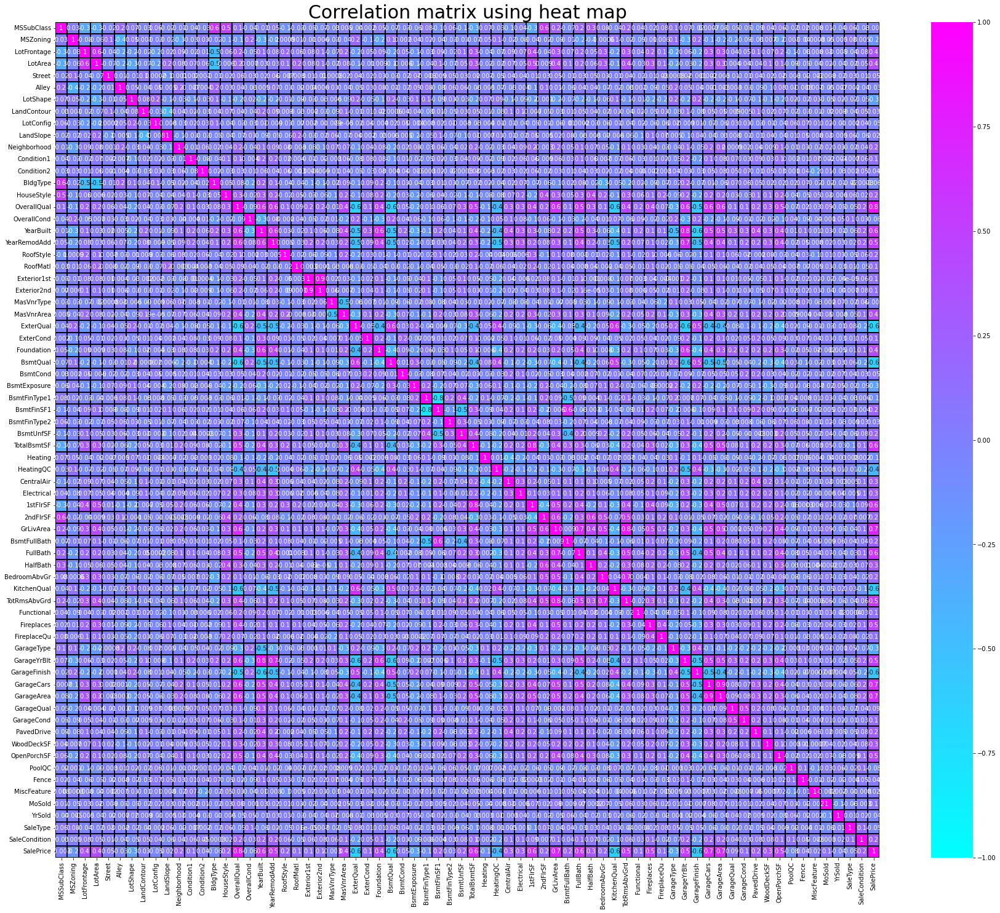

In [85]:
plt.figure(figsize=(30,25))
sns.heatmap(correlation,linewidths=.1,vmin=-1, vmax=1, fmt='.1g',linecolor="black", annot = True, annot_kws={'size':10},cmap="cool")
plt.title('Correlation matrix using heat map',fontsize=30)
plt.show()

In [86]:
correlation['SalePrice'].sort_values(ascending=False).to_frame("Correlation between label and features")

,Correlation between label and features
SalePrice,1.000000
OverallQual,0.810743
GrLivArea,0.715373
GarageCars,0.661707
GarageArea,0.652714
TotalBsmtSF,0.635477
1stFlrSF,0.589351
FullBath,0.566105
YearBuilt,0.555805
YearRemodAdd,0.543019


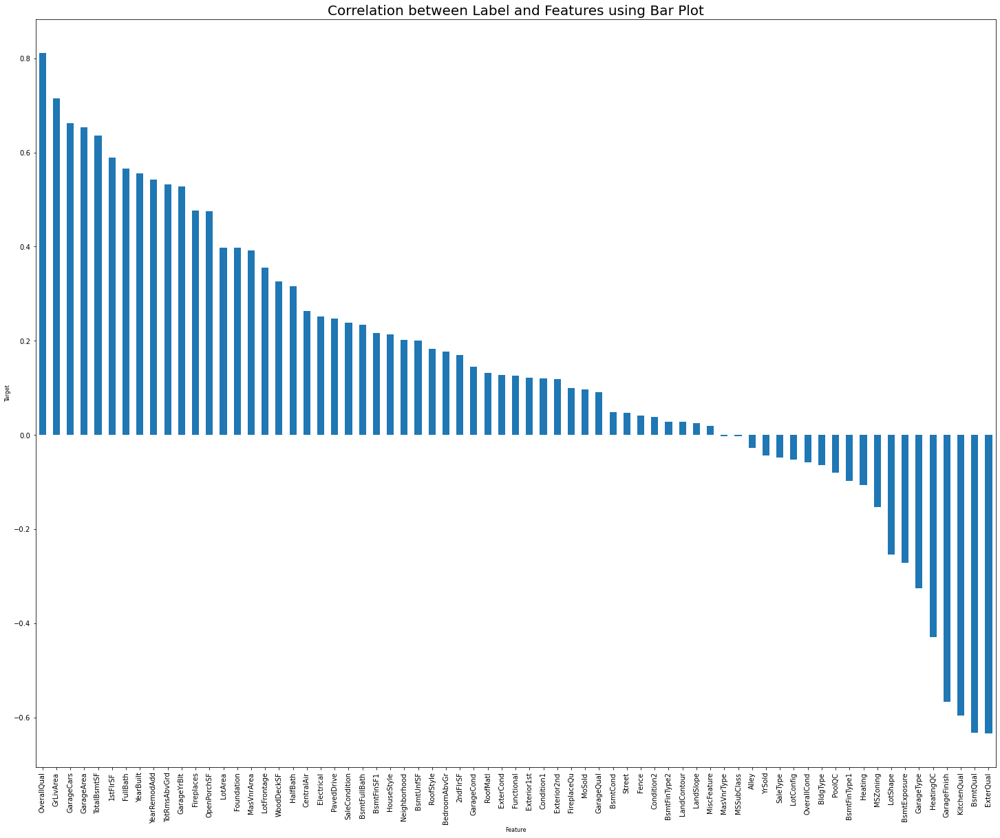

In [87]:
plt.figure(figsize=(25,20))
train_df.corr()['SalePrice'].sort_values(ascending=False).drop('SalePrice').plot(kind='bar')
plt.xlabel('Feature',fontsize=8)
plt.ylabel('Target',fontsize=8)
plt.title('Correlation between Label and Features using Bar Plot',fontsize=20)
plt.show()

In [88]:
x = train_df.drop('SalePrice', axis=1)
y = train_df['SalePrice']

In [89]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x.head().T

,0,1,2,3,4
MSSubClass,1.370435,-1.167999,0.490047,-1.167999,-1.167999
MSZoning,-0.021646,-0.021646,-0.021646,-0.021646,-0.021646
LotFrontage,0.039092,1.321126,1.160948,1.855050,0.039092
LotArea,-1.306083,1.356458,0.113089,0.530989,1.497522
Street,0.058621,0.058621,0.058621,0.058621,0.058621
Alley,-0.178331,-0.178331,-0.178331,-0.178331,-0.178331
LotShape,-1.373107,-1.373107,-1.373107,-1.373107,-1.373107
LandContour,0.318473,0.318473,0.318473,0.318473,0.318473
LotConfig,0.606420,0.606420,-1.220661,0.606420,-0.611634
LandSlope,-0.226126,3.295414,-0.226126,-0.226126,-0.226126


In [90]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
              for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,5.709599,MSSubClass
1,1.609511,MSZoning
2,2.092449,LotFrontage
3,2.681362,LotArea
4,1.112512,Street
5,1.482944,Alley
6,1.289229,LotShape
7,1.316659,LandContour
8,1.157333,LotConfig
9,1.449304,LandSlope


In [91]:
x.drop('1stFlrSF',axis=1,inplace=True)

In [92]:
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i)
              for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,5.663459,MSSubClass
1,1.609126,MSZoning
2,2.086680,LotFrontage
3,2.670110,LotArea
4,1.109935,Street
5,1.481939,Alley
6,1.288866,LotShape
7,1.316383,LandContour
8,1.157121,LotConfig
9,1.449041,LandSlope


In [93]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

In [94]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    RFG = RandomForestRegressor()
    RFG.fit(x_train, y_train)
    pred = RFG.predict(x_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.916508823679508  on Random_state  72


# Maximum Accuracy is 92% at the best random state 72

In [95]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=maxRS)

In [96]:
x_train

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolQC,Fence,MiscFeature,MoSold,YrSold,SaleType,SaleCondition
1108,0.786959,-0.021646,-0.547609,-0.266763,0.058621,-0.178331,0.752055,-3.908531,0.606420,3.295414,0.974477,-0.037339,-0.023979,-0.403288,-0.023008,-0.818792,2.019532,-1.076387,0.589202,-0.483544,-0.134573,1.079014,1.050880,0.395209,-0.822896,0.671093,0.369322,0.852451,0.836731,0.293234,0.635539,0.109523,0.435880,0.310141,-0.266128,-0.834611,-0.119090,-0.897602,0.267506,0.299036,1.137313,1.339849,-0.838227,0.793082,1.268421,1.475072,-0.394851,0.975397,0.261146,0.606782,-0.430193,1.571019,-1.493030,0.946709,-1.048629,-1.137469,0.215316,0.187193,0.291828,1.166953,0.427319,0.055603,0.260130,0.037037,0.244236,0.146863,0.330033,0.207932
422,0.490047,-0.021646,0.520239,0.074658,0.058621,-0.178331,0.752055,0.318473,0.606420,3.295414,-0.024227,-0.037339,-0.023979,-0.403288,1.030838,-0.072810,0.458609,-0.236650,-0.999147,-0.483544,-0.134573,-1.181882,-1.260660,-1.241686,1.339120,0.671093,0.369322,-0.557836,0.836731,0.293234,-1.113129,-0.434828,0.775579,-1.852512,-2.039217,-0.683453,-0.119090,1.390230,0.267506,0.299036,1.160822,0.340862,1.192995,-1.019676,1.268421,1.475072,0.806154,0.313788,0.261146,-0.961186,-0.430193,-0.693653,-0.731533,-0.288773,0.307737,-0.154070,0.215316,0.187193,0.291828,1.237271,1.201277,0.055603,0.260130,0.037037,-0.128176,0.146863,0.330033,0.207932
610,-1.167999,-0.021646,1.054164,0.419919,0.058621,-0.178331,-1.373107,0.318473,-1.829688,-0.226126,-1.189380,-0.037339,-0.023979,-0.403288,-0.549930,2.165136,-0.501011,1.039749,0.829861,1.919773,-0.134573,0.756029,0.761937,2.032104,1.247755,-0.759266,0.369322,0.852451,-0.329500,0.293234,-1.987463,-0.434828,1.074363,0.310141,0.242891,1.447879,-0.119090,-0.897602,0.267506,0.299036,-0.871789,0.452230,1.192995,0.793082,-0.782707,0.165053,-0.394851,0.313788,0.261146,0.606782,1.778446,-0.693653,1.066058,-1.524255,1.664104,1.111692,0.215316,0.187193,0.291828,1.160876,0.713758,0.055603,0.260130,0.037037,0.244236,-0.605487,0.330033,0.207932
1085,-1.167999,-0.021646,0.146492,0.097517,0.058621,-0.178331,0.752055,0.318473,-1.829688,-0.226126,-0.856479,-0.037339,-0.023979,-0.403288,-0.549930,-0.072810,-0.501011,-0.505366,-1.384201,1.919773,-0.134573,1.079014,1.050880,0.395209,-0.822896,0.671093,0.369322,-0.557836,0.836731,0.293234,0.635539,1.198224,-1.349315,0.310141,1.563861,0.969211,-0.119090,-0.325644,0.267506,0.299036,-0.871789,0.492392,-0.838227,-1.019676,-0.782707,0.165053,0.806154,0.313788,0.261146,0.606782,-0.430193,-0.693653,-1.004504,0.946709,0.307737,0.030926,0.215316,0.187193,0.291828,-0.960144,-1.062308,0.055603,0.260130,0.037037,1.733882,0.899213,-4.612004,0.207932
1131,-1.167999,-0.021646,1.054164,0.582432,0.058621,-0.178331,-1.373107,0.318473,-1.829688,-0.226126,-0.024227,-1.185010,-0.023979,-0.403288,-0.549930,-0.072810,0.458609,-0.471776,-1.336070,-0.483544,-0.134573,0.756029,0.761937,0.395209,-0.822896,0.671093,0.369322,-0.557836,0.836731,0.293234,0.635539,0.653873,0.866284,0.310141,0.033012,0.485505,-0.119090,-0.897602,0.267506,-3.539146,-0.871789,-0.476008,-0.838227,-1.019676,1.268421,0.165053,0.806154,-0.347820,0.261146,2.174749,-0.430193,-0.693653,-0.972013,0.946709,-1.048629,-0.670111,0.215316,0.187193,0.291828,-0.960144,0.659599,0.055603,0.260130,0.037037,-0.500587,-0.605487,0.330033,0.207932
1129,-0.517772,1.558511,-0.547609,-0.676880,0.058621,-

In [97]:
x_test

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,2ndFlrSF,GrLivArea,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolQC,Fence,MiscFeature,MoSold,YrSold,SaleType,SaleCondition
766,-1.167999,-0.021646,0.039092,0.658259,0.058621,-0.178331,-1.373107,0.318473,0.606420,-0.226126,-0.024227,-0.037339,-0.023979,-0.403288,-0.549930,-0.818792,-0.501011,-0.371008,-0.325302,1.919773,-0.134573,1.079014,1.050880,0.395209,-0.822896,0.671093,0.369322,-0.557836,0.836731,0.293234,0.635539,1.198224,-1.349315,0.310141,0.946884,-0.184630,-0.119090,1.390230,0.267506,0.299036,-0.871789,-0.055894,-0.838227,-1.019676,-0.782707,0.165053,0.806154,-0.347820,-3.792250,0.606782,1.778446,-0.693653,-0.871794,-0.288773,-1.048629,-0.913527,0.215316,0.187193,0.291828,-0.960144,-1.062308,0.055603,-1.925714,0.037037,0.616647,-0.605487,0.330033,0.207932
184,1.888917,-0.021646,-0.013685,-0.651097,0.058621,-0.178331,0.752055,0.318473,0.606420,-0.226126,-0.856479,-0.037339,-0.023979,0.443907,1.030838,-0.818792,1.288527,-2.050481,0.300412,-0.483544,-0.134573,-0.535912,-0.682775,0.395209,-0.822896,0.671093,0.369322,-0.557836,-0.329500,0.293234,-1.113129,-0.434828,1.013155,0.310141,-0.882193,0.165553,-0.119090,1.390230,0.267506,0.299036,1.075258,-0.226741,1.192995,-1.019676,-0.782707,0.165053,0.806154,-1.009429,0.261146,-0.961186,-0.430193,-0.693653,-0.166505,0.946709,-2.404996,-2.305865,0.215316,0.187193,-3.694781,0.800068,-1.062308,0.055603,0.260130,0.037037,-1.990233,0.146863,0.330033,0.207932
726,-0.517772,-0.021646,-0.761179,-1.597847,0.058621,-0.178331,-1.373107,0.318473,0.606420,-0.226126,-1.522282,-0.037339,-0.023979,-0.403288,-0.549930,-2.310756,0.458609,-1.210744,0.877993,-0.483544,-0.134573,0.756029,0.761937,0.395209,-0.822896,-0.759266,0.369322,-0.557836,0.836731,0.293234,0.635539,1.198224,-1.349315,0.310141,-0.465429,-1.968298,-0.119090,0.246314,0.267506,0.299036,-0.871789,-2.103630,-0.838227,-1.019676,-0.782707,-1.144966,0.806154,-1.009429,-4.805598,-0.961186,-0.430193,-0.693653,-0.166505,0.946709,-2.404996,-2.305865,0.215316,0.187193,-3.694781,-0.960144,-1.062308,0.055603,0.260130,0.037037,0.244236,0.146863,0.330033,0.207932
36,-1.167999,-0.021646,0.520239,0.226414,0.058621,-0.178331,0.752055,0.318473,0.606420,-0.226126,0.308675,-0.037339,-0.023979,-0.403288,-0.549930,0.673172,-0.501011,0.166423,-0.421565,-0.483544,-0.134573,-1.181882,-1.260660,-1.241686,1.223131,0.671093,0.369322,-0.557836,-0.329500,0.293234,0.635539,1.198224,-1.349315,0.310141,1.109853,0.097532,-0.119090,1.390230,0.267506,0.299036,-0.871789,-0.173449,-0.838227,0.793082,-0.782707,0.165053,0.806154,-0.347820,0.261146,0.606782,1.778446,-0.693653,-0.261199,-0.288773,0.307737,0.026058,0.215316,0.187193,0.291828,-0.960144,-1.062308,0.055603,0.260130,0.037037,-0.128176,0.899213,0.330033,-0.691566
679,1.700798,1.558511,-2.469737,-2.642867,0.058621,-0.178331,0.752055,0.318473,0.606420,-0.226126,-1.855183,-0.037339,-0.023979,2.985495,1.030838,-0.072810,0.458609,0.300781,-0.229038,-0.483544,-0.134573,-0.535912,-0.682775,0.395209,-0.822896,0.671093,0.369322,-0.557836,-0.329500,0.293234,0.635539,-1.523529,0.285799,0.310141,-0.447825,-1.235180,-0.119090,1.390230,0.267506,0.299036,1.122626,-0.513860,-0.838227,-1.019676,1.268421,-1.144966,0.806154,-1.009429,0.261146,0.606782,1.778446,-0.693653,-0.086379,-1.524255,0.307737,-0.056703,0.215316,0.187193,0.291828,0.988186,-1.062308,0.055603,-4.111558,0.037037,-0.500587,0.899213,0.330033,0.207932
382,-1.167999,-0.021646,-0.

In [98]:
y_train

1108    179500.0
422     167900.0
610     285000.0
1085    127500.0
1131    150000.0
1129    100000.0
1109    195000.0
639     129000.0
862     318061.0
1019    108000.0
1094     81000.0
865     106000.0
617     153900.0
428     175000.0
308     132500.0
175     130000.0
702     240000.0
224     199900.0
772     253293.0
277     137500.0
416     144000.0
972     117000.0
228     114500.0
551     127500.0
293     110000.0
978     180500.0
1128    138500.0
843     154000.0
590     122000.0
465     177500.0
534     191000.0
1024    133500.0
842     172500.0
337     130500.0
1057    175000.0
1149    135000.0
119     385000.0
206     262500.0
516     213500.0
168     225000.0
374     214900.0
981     315750.0
107     135000.0
1052    140000.0
814     165000.0
757     380000.0
1143    301500.0
395     178400.0
438     164000.0
421     207500.0
489     132250.0
663     261500.0
111     176432.0
804     135900.0
658      97000.0
640     139000.0
113     302000.0
231      89500.0
676      93000

In [99]:
y_test

766     139900.0
184     107500.0
726      60000.0
36      152000.0
679     124000.0
382     193879.0
963     119000.0
476     119500.0
477     132000.0
216     159000.0
147     163500.0
179     140000.0
187     175000.0
1121    266000.0
351     135000.0
685     110000.0
547     175500.0
939     206900.0
1159    150000.0
995     184100.0
474     100000.0
420      81000.0
457     184000.0
944     136905.0
1079    169900.0
1144    266500.0
266     175500.0
623     153500.0
444     318000.0
380     201800.0
495     165150.0
471     175000.0
779     172500.0
22      142125.0
152     333168.0
847     162900.0
632     285000.0
554     155000.0
570     157500.0
306     145000.0
890     160000.0
761     139000.0
442     293077.0
413     131500.0
427     208500.0
933     150750.0
622     345000.0
222     315500.0
778     219500.0
668      85000.0
631     200000.0
762     386250.0
752     147000.0
359     180500.0
625     157000.0
1093    129000.0
932     272000.0
1155    104900.0
773     151000

In [100]:
from sklearn.model_selection import cross_val_score

In [101]:
rfr = RandomForestRegressor()
rfr.fit(x_train,y_train)
rfrpred=rfr.predict(x_test)
print('R2_Score:',r2_score(y_test,rfrpred))
print('MAE:',mean_absolute_error(y_test, rfrpred))
print('MSE:',mean_squared_error(y_test, rfrpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, rfrpred)))
print("Cross_Validaton_Score",cross_val_score(rfr,x,y,cv=5).mean())

R2_Score: 0.9163313160526597
MAE: 15006.15555555556
MSE: 415877560.9065705
RMSE: 20393.076298257958
Cross_Validaton_Score 0.8775743191625309


In [102]:
from sklearn.svm import SVR
svr = SVR()
svr.fit(x_train,y_train)
svrpred=svr.predict(x_test)
print('R2_Score:',r2_score(y_test,svrpred))
print('MAE:',mean_absolute_error(y_test, svrpred))
print('MSE:',mean_squared_error(y_test, svrpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, svrpred)))
print("Cross_Validaton_Score",cross_val_score(svr,x,y,cv=5).mean())

R2_Score: -0.055043446709241106
MAE: 53644.365441885915
MSE: 5244123303.577413
RMSE: 72416.31931807507
Cross_Validaton_Score -0.06453280296115219


In [103]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(x_train,y_train)
lrpred=lr.predict(x_test)
print('R2_score:',r2_score(y_test,lrpred))
print('MAE:',mean_absolute_error(y_test, lrpred))
print('MSE:',mean_squared_error(y_test, lrpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, lrpred)))
print("Cross_Validaton_Score",cross_val_score(lr,x,y,cv=5).mean())

R2_score: 0.9055889437624671
MAE: 16874.651833305837
MSE: 469272826.32280904
RMSE: 21662.70588644939
Cross_Validaton_Score 0.8520731190269025


In [104]:
from sklearn.linear_model import SGDRegressor
sgd = SGDRegressor()
sgd.fit(x_train,y_train)
sgdpred=sgd.predict(x_test)
print('R2_Score:',r2_score(y_test,sgdpred))
print('MAE:',mean_absolute_error(y_test, sgdpred))
print('MSE:',mean_squared_error(y_test, sgdpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, sgdpred)))
print("Cross_Validaton_Score",cross_val_score(sgd,x,y,cv=5).mean())

R2_Score: 0.9073961119317414
MAE: 16845.415148848773
MSE: 460290245.80488443
RMSE: 21454.375912733616
Cross_Validaton_Score 0.8518245688960219


In [105]:
from sklearn.neighbors import KNeighborsRegressor
knr = KNeighborsRegressor()
knr.fit(x_train,y_train)
knrpred=knr.predict(x_test)
print('R2_Score:',r2_score(y_test,knrpred))
print('MAE:',mean_absolute_error(y_test, knrpred))
print('MSE:',mean_squared_error(y_test, knrpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, knrpred)))
print("Cross_Validaton_Score",cross_val_score(knr,x,y,cv=5).mean())

R2_Score: 0.8271192598168915
MAE: 21402.447863247864
MSE: 859308610.6185757
RMSE: 29313.96613593213
Cross_Validaton_Score 0.7820142349615625


In [106]:
from sklearn.ensemble import GradientBoostingRegressor
gbr = GradientBoostingRegressor()
gbr.fit(x_train,y_train)
gbrpred=gbr.predict(x_test)
print('R2_Score:',r2_score(y_test,gbrpred))
print('MAE:',mean_absolute_error(y_test, gbrpred))
print('MSE:',mean_squared_error(y_test, gbrpred))
print("RMSE:",np.sqrt(mean_squared_error(y_test, gbrpred)))
print("Cross_Validaton_Score",cross_val_score(gbr,x,y,cv=5).mean())

R2_Score: 0.9155816162726059
MAE: 14751.17165201443
MSE: 419603964.87555355
RMSE: 20484.236985437205
Cross_Validaton_Score 0.8878142934333052


In [107]:
parameters={'loss' : ['squared_error', 'absolute_error', 'huber', 'quantile'],
            'max_features' : ['auto', 'sqrt', 'log2'],
           'learning_rate':[0.1,.2,.4,.5],
           'criterion' : ['friedman_mse', 'squared_error', 'mse'], 
}

In [108]:
from sklearn.model_selection import GridSearchCV

In [109]:
gscv=GridSearchCV(GradientBoostingRegressor(),parameters,cv=5)
gscv.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=GradientBoostingRegressor(),
             param_grid={'criterion': ['friedman_mse', 'squared_error', 'mse'],
                         'learning_rate': [0.1, 0.2, 0.4, 0.5],
                         'loss': ['squared_error', 'absolute_error', 'huber',
                                  'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2']})

In [110]:
gscv.best_params_

{'criterion': 'mse',
 'learning_rate': 0.1,
 'loss': 'absolute_error',
 'max_features': 'auto'}

In [111]:
gscv.best_estimator_

GradientBoostingRegressor(criterion='mse', loss='absolute_error',
                          max_features='auto')

In [112]:
gscvpred1=gscv.best_estimator_.predict(x_test)
gscv.best_estimator_.score(x_train,y_train)

0.9420947302913055

In [113]:
final_model=GradientBoostingRegressor(max_depth=4)

In [114]:
final_model.fit(x_test,y_test)
pred=final_model.predict(x_test)
final_model.fit(x_train,y_train)
pred1=final_model.predict(x_train)

In [115]:
print("Test Accuracy=",final_model.score(x_test,y_test))
print("Train Accuracy=",final_model.score(x_train,y_train))

Test Accuracy= 0.9238113053495993
Train Accuracy= 0.9865543876443633


In [116]:
import joblib
joblib.dump(final_model,"Housing Project.pkl")

['Housing Project.pkl']

In [117]:
model=joblib.load("Housing Project.pkl")
Prediction = model.predict(x_test)
Prediction

array([135449.86950772, 131607.51638068,  89527.34264577, 168712.7758427 ,
       133762.54407446, 191637.61533508, 126502.19389648, 121352.53313996,
       128551.05327077, 166299.48804596, 142049.99095929, 167659.55342782,
       151336.94102066, 294615.39077475, 114977.75250585, 127552.73304989,
       166412.35828713, 179050.84016731, 128750.45747888, 198129.66391937,
        86562.48567406,  96489.24480538, 198800.84832754, 137268.19101033,
       147922.92839084, 250431.41331055, 180740.29380258, 135940.06277273,
       255238.41594534, 201172.44844125, 158487.35548258, 162853.86886703,
       167930.15188882, 133189.40466512, 338873.24105634, 179032.33513988,
       298293.35768895, 153245.39196366, 161290.71226904, 152297.75883034,
       134443.43595013, 161890.36379696, 332673.06521672, 124448.47781945,
       200583.08712928, 145800.90046352, 338042.13771599, 329161.15689338,
       192419.07946823,  77073.26559303, 201589.3629277 , 363640.90165806,
       130201.59574602, 1

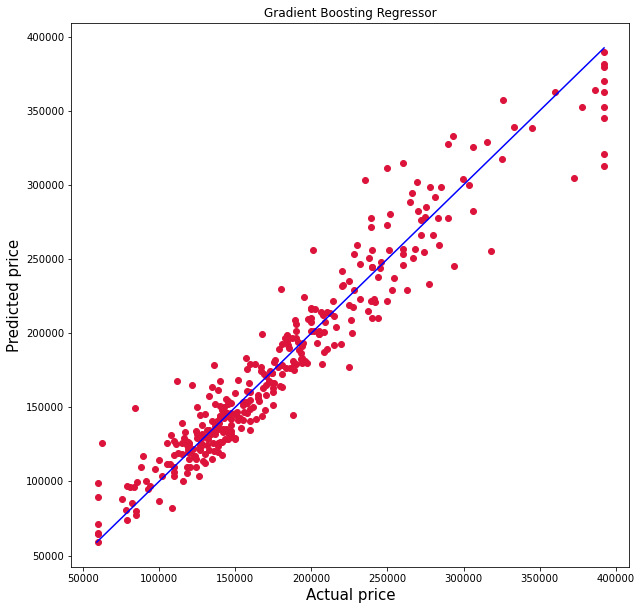

In [118]:
plt.figure(figsize=(10,10))
plt.scatter(y_test, Prediction, c='crimson')
plt1 = max(max(Prediction), max(y_test))
plt2 = min(min(Prediction), min(y_test))
plt.plot([plt1, plt2], [plt1, plt2], 'b-')
plt.title("Gradient Boosting Regressor")
plt.xlabel('Actual price', fontsize=15)
plt.ylabel('Predicted price', fontsize=15)
plt.show()

# Load The Test Data

In [119]:
path = "/Users/aerryjoop/Desktop/test.csv"

In [120]:
test_df = pd.read_csv(path)

In [121]:
pd.set_option('display.max_rows', 1500)
pd.set_option('display.max_columns', 1500)
pd.set_option('display.width', 1000)
pd.set_option('display.max_rows',None)

In [122]:
test_df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,337,20,RL,86.0,14157,Pave,NaN,IR1,HLS,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,9,5,2005,2006,Hip,CompShg,VinylSd,VinylSd,Stone,200.0,Gd,TA,PConc,Ex,TA,Gd,GLQ,1249,Unf,0,673,1922,GasA,Ex,Y,SBrkr,1922,0,0,1922,1,0,2,0,3,1,Gd,8,Typ,1,Gd,Attchd,2005.0,Fin,3,676,TA,TA,Y,178,51,0,0,0,0,NaN,NaN,NaN,0,7,2007,WD,Normal
1,1018,120,RL,NaN,5814,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,CBlock,Gd,TA,Av,GLQ,1036,Unf,0,184,1220,GasA,Gd,Y,SBrkr,1360,0,0,1360,1,0,1,0,1,1,Gd,4,Typ,1,Ex,Attchd,1984.0,RFn,2,565,TA,TA,Y,63,0,0,0,0,0,NaN,NaN,NaN,0,8,2009,COD,Abnorml
2,929,20,RL,NaN,11838,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,1Story,8,5,2001,2001,Hip,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,1753,1753,GasA,Ex,Y,SBrkr,1788,0,0,1788,0,0,2,0,3,1,Ex,7,Typ,1,TA,Attchd,2001.0,RFn,2,522,TA,TA,Y,202,151,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal
3,1148,70,RL,75.0,12000,Pave,NaN,Reg,Bnk,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,7,1941,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,275,Unf,0,429,704,GasA,Ex,Y,SBrkr,860,704,0,1564,0,0,1,1,3,1,Fa,7,Typ,1,Gd,Attchd,1941.0,Unf,1,234,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal
4,1227,60,RL,86.0,14598,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Somerst,Feedr,Norm,1Fam,2Story,6,5,2007,2007,Gable,CompShg,VinylSd,VinylSd,Stone,74.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0,Unf,0,894,894,GasA,Ex,Y,SBrkr,894,1039,0,1933,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2007.0,Fin,3,668,TA,TA,Y,100,18,0,0,0,0,NaN,NaN,NaN,0,1,2008,WD,Normal
5,650,180,RM,21.0,1936,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,SFoyer,4,6,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,Gd,TA,Av,BLQ,131,GLQ,499,0,630,GasA,Gd,Y,SBrkr,630,0,0,630,1,0,1,0,1,1,TA,3,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,Y,0,0,0,0,0,0,NaN,MnPrv,NaN,0,12,2007,WD,Normal
6,1453,180,RM,35.0,3675,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SLvl,5,5,2005,2005,Gable,CompShg,VinylSd,VinylSd,BrkFace,80.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547,Unf,0,0,547,GasA,Gd,Y,SBrkr,1072,0,0,1072,1,0,1,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2,525,TA,TA,Y,0,28,0,0,0,0,NaN,NaN,NaN,0,5,2006,WD,Normal
7,152,20,RL,107.0,13891,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,1Fam,1Story,8,5,2007,2008,Hip,CompShg,VinylSd,VinylSd,Stone,436.0,Gd,TA,PConc,Ex,TA,Gd,GLQ,1400,Unf,0,310,1710,GasA,Ex,Y,SBrkr,1710,0,0,1710,1,0,2,0,2,1,Gd,6,Typ,1,Gd,Attchd,2007.0,RFn,3,866,TA,TA,Y,0,102,0,0,0,0,NaN,NaN,NaN,0,1,2008,New,Partial
8,427,80,RL,NaN,12800,Pave,NaN,Reg,Low,AllPub,Inside,Mod,SawyerW,Norm,Norm,1Fam,SLvl,7,5,1989,1989,Gable,CompShg,Wd Sdng,Wd Sdng,BrkFace,145.0,Gd,TA,PConc,Gd,TA,Gd,GLQ,1518,Unf,0,0,1518,GasA,Gd,Y,SBrkr,1644,0,0,1644,1,1,2,0,2,1,Gd,5,Typ,1,TA,Attchd,1989.0,Fin,2,569,TA,TA,Y,80,0,0,0,396,0,NaN,NaN,NaN,0,8,2009,WD,Normal
9,776,120,RM,32.0,4500,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Mitchel,Norm,Norm,TwnhsE,1Story,6,5,1998,1998,Hip,CompShg,VinylSd,VinylSd,BrkFace,320.0,TA,TA,PConc,Ex,TA,No,GLQ,866,Unf,0,338,1204,GasA,Ex,Y,SBrkr,1204,0,0,1204,1,0,2,0,2,1,TA,5,Typ,0,NaN,Attchd,1998.0,Fin,2,412,TA,TA,

In [123]:
test_df.shape

(292, 80)

In [124]:
test_df.drop_duplicates(inplace=True)

In [125]:
test_df.shape

(292, 80)

In [126]:
test_df.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage       45
LotArea            0
Street             0
Alley            278
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         1
MasVnrArea         1
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           7
BsmtCond           7
BsmtExposure       7
BsmtFinType1       7
BsmtFinSF1         0
BsmtFinType2       7
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
Heating            0
HeatingQC          0
CentralAir         0
Electrical         1
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath 

In [127]:
test_df.isnull().sum().sum()

1407

In [128]:
test_df['LotFrontage'] = test_df['LotFrontage'].fillna(test_df['LotFrontage'].mean())
test_df['Alley'] = test_df['Alley'].fillna(test_df['Alley'].mode()[0])
test_df['MasVnrType'] = test_df['MasVnrType'].fillna(test_df['MasVnrType'].mode()[0])
test_df['MasVnrArea'] = test_df['MasVnrArea'].fillna(test_df['MasVnrArea'].mean())
test_df['BsmtQual'] = test_df['BsmtQual'].fillna(test_df['BsmtQual'].mode()[0])
test_df['BsmtCond'] = test_df['BsmtCond'].fillna(test_df['BsmtCond'].mode()[0])
test_df['BsmtExposure'] = test_df['BsmtExposure'].fillna(test_df['BsmtExposure'].mode()[0])
test_df['BsmtFinType1'] = test_df['BsmtFinType1'].fillna(test_df['BsmtFinType1'].mode()[0])
test_df['BsmtFinType2'] = test_df['BsmtFinType2'].fillna(test_df['BsmtFinType2'].mode()[0])
test_df['Electrical'] = test_df['Electrical'].fillna(test_df['Electrical'].mode()[0])
test_df['FireplaceQu'] = test_df['FireplaceQu'].fillna(test_df['FireplaceQu'].mode()[0])
test_df['GarageType'] = test_df['GarageType'].fillna(test_df['GarageType'].mode()[0])
test_df['GarageYrBlt'] = test_df['GarageYrBlt'].fillna(test_df['GarageYrBlt'].mean())
test_df['GarageFinish'] = test_df['GarageFinish'].fillna(test_df['GarageFinish'].mode()[0])
test_df['GarageQual'] = test_df['GarageQual'].fillna(test_df['GarageQual'].mode()[0])
test_df['GarageCond'] = test_df['GarageCond'].fillna(test_df['GarageCond'].mode()[0])
test_df['Fence'] = test_df['Fence'].fillna(test_df['Fence'].mode()[0])
test_df['MiscFeature'] = test_df['MiscFeature'].fillna(test_df['MiscFeature'].mode()[0])
test_df['PoolQC'] = test_df['PoolQC'].fillna(test_df['PoolQC'].mean())

In [129]:
test_df.isnull().sum().sum()

292

In [130]:
test_df['PoolQC'] = test_df['PoolQC'].fillna(0)

In [131]:
test_df.isnull().sum().sum()

0

In [132]:
test_df.drop(['Id', 'Utilities'],axis=1,inplace=True)

In [133]:
test_df.drop(['3SsnPorch', 'PoolArea', 'LowQualFinSF'],axis=1,inplace=True)

In [134]:
test_df.drop(['BsmtHalfBath', 'KitchenAbvGr', 'MiscVal', 'ScreenPorch', 'BsmtFinSF2', 'EnclosedPorch'],axis=1,inplace=True)

In [135]:
test_df_cc=[]
for i in test_df.dtypes.index:
    if test_df.dtypes[i]=='object':
        test_df_cc.append(i)
print(test_df_cc)

['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition']


In [136]:
len(test_df_cc)

41

In [137]:
test_df_nc=[]
for i in test_df.dtypes.index:
    if test_df.dtypes[i]!='object':
        test_df_nc.append(i)
print(test_df_nc)

['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'PoolQC', 'MoSold', 'YrSold']


In [138]:
len(test_df_nc)

28

In [139]:
len(test_df.dtypes.index)==len(test_df_cc)+len(test_df_nc)

True

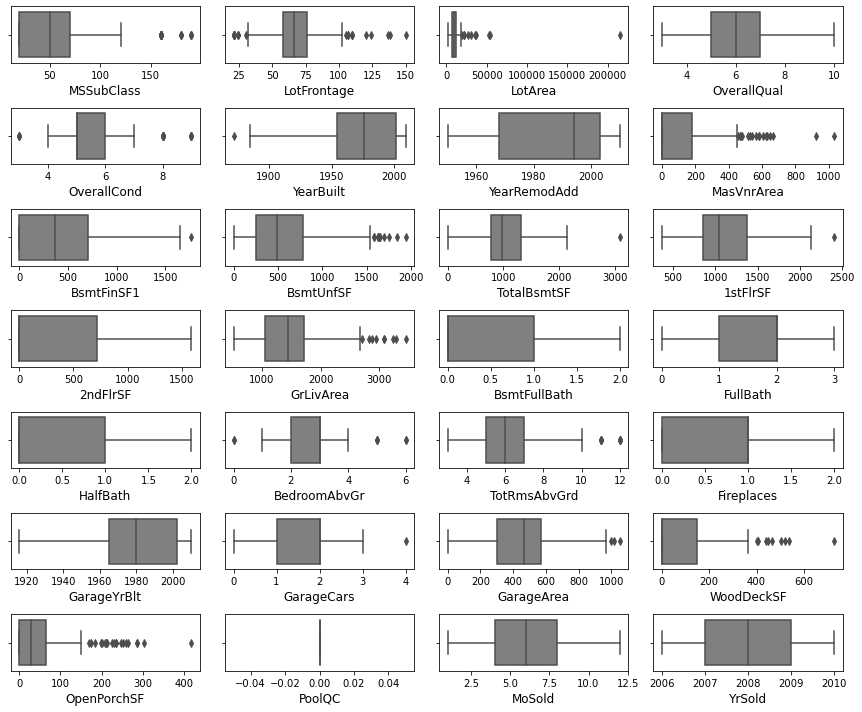

In [140]:
plt.figure(figsize=(12,10),facecolor='white')
plotnumber=1
for column in test_df_nc:
    if plotnumber<=28:
        ax=plt.subplot(7,4,plotnumber)
        sns.boxplot(test_df[column],color='gray')
        plt.xlabel(column,fontsize=12)
    plotnumber+=1
plt.tight_layout()

In [141]:
ff = test_df[['MSSubClass', 'LotFrontage', 'LotArea', 'OverallCond' ,'YearBuilt', 'MasVnrArea', 'BsmtFinSF1', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF' , 'GrLivArea', 'BedroomAbvGr', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea','WoodDeckSF','OpenPorchSF']]

In [142]:
for col in ff:
    if train_df[col].dtypes != 'object':
        percentile = train_df[col].quantile([0.01,0.98]).values
        train_df[col][train_df[col]<=percentile[0]]=percentile[0]
        train_df[col][train_df[col]>=percentile[1]]=percentile[1]

In [143]:
test_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
LotArea,12.781805
OpenPorchSF,2.185030
MasVnrArea,1.976804
WoodDeckSF,1.708221
MSSubClass,1.358597
OverallCond,1.209714
GrLivArea,1.010586
BsmtUnfSF,0.960708
TotRmsAbvGrd,0.805535
2ndFlrSF,0.765511


In [144]:
test_df.drop(['PoolQC'],axis=1,inplace=True)

In [145]:
scaler = PowerTransformer(method='yeo-johnson')
test_df [['LotArea', 'OpenPorchSF', 'MasVnrArea', 'WoodDeckSF', 'MSSubClass', 'OverallCond', 'GrLivArea', 'BsmtUnfSF', 'TotRmsAbvGrd', '2ndFlrSF', 'HalfBath', 'BsmtFinSF1', 'YearBuilt', 'GarageYrBlt']]= scaler.fit_transform(test_df[['LotArea', 'OpenPorchSF', 'MasVnrArea', 'WoodDeckSF', 'MSSubClass', 'OverallCond', 'GrLivArea', 'BsmtUnfSF', 'TotRmsAbvGrd', '2ndFlrSF', 'HalfBath', 'BsmtFinSF1', 'YearBuilt', 'GarageYrBlt']].values)

In [146]:
test_df.skew().sort_values(ascending=False).to_frame("Check skewness present in features")

,Check skewness present in features
1stFlrSF,0.692047
HalfBath,0.621093
Fireplaces,0.540164
TotalBsmtSF,0.519257
LotFrontage,0.466813
BsmtFullBath,0.463685
OverallQual,0.397312
MasVnrArea,0.363253
2ndFlrSF,0.284246
WoodDeckSF,0.210102


In [147]:
test_df[test_df_cc]= test_df[test_df_cc].apply(le.fit_transform)
test_df[test_df_cc]

,MSZoning,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,Fence,MiscFeature,SaleType,SaleCondition
0,2,1,0,0,1,0,0,21,2,0,0,2,3,0,9,11,3,2,3,2,0,2,1,2,5,0,0,1,3,2,5,2,1,0,4,4,2,2,1,5,2
1,2,1,0,0,3,1,0,21,2,0,4,2,1,0,5,5,2,2,3,1,2,2,0,2,5,0,2,1,3,2,5,0,1,1,4,4,2,2,1,0,0
2,2,1,0,3,3,4,0,4,2,0,0,2,3,0,9,11,2,2,3,2,2,2,0,5,5,0,0,1,3,0,5,4,1,1,4,4,2,2,1,5,2
3,2,1,0,3,0,4,0,5,2,0,0,5,1,0,6,7,2,3,3,1,3,2,3,4,5,0,0,1,3,1,5,2,1,2,4,4,2,2,1,5,2
4,2,1,0,0,3,1,0,20,1,0,0,5,1,0,9,11,3,2,3,2,2,2,2,5,5,0,0,1,3,2,5,2,3,0,4,4,2,2,1,5,2
5,3,1,0,3,3,4,0,9,2,0,3,6,1,0,4,4,2,3,3,1,2,2,0,1,2,0,2,1,3,3,5,2,1,2,4,4,2,2,1,5,2
6,3,1,0,3,3,4,0,6,2,0,4,7,1,0,9,11,1,3,3,2,2,2,1,2,5,0,2,1,3,3,5,2,2,0,4,4,2,2,1,5,2
7,2,1,0,3,3,4,0,15,2,0,0,2,3,0,9,11,3,2,3,2,0,2,1,2,5,0,0,1,3,2,5,2,1,1,4,4,2,2,1,4,3
8,2,1,0,3,2,4,1,19,2,0,0,7,1,0,10,12,1,2,3,2,2,2,1,2,5,0,2,1,3,2,5,4,1,0,4,4,2,2,1,5,2
9,3,1,0,3,3,2,0,10,2,0,4,2,3,0,9,11,1,3,3,2,0,2,3,2,5,0,0,1,3,3,5,2,1,0,4,4,2,2,1,5,2


In [148]:
model = joblib.load("Housing Project.pkl")
prediction = model.predict(test_df)
prediction

array([296882.49443457, 275806.57116203, 246299.8851873 , 332710.51723243,
       301019.55482376, 248037.70837813, 244122.90317193, 320161.60501304,
       293281.69041976, 273319.57314595, 239818.43932491, 234373.86335818,
       256376.84694709, 283148.06248268, 252234.74909732, 305523.85178936,
       229518.40259298, 238295.33629185, 302704.7082942 , 314378.1240751 ,
       312124.73114076, 241664.39258172, 245824.09852234, 266770.61626303,
       241632.78249388, 241559.26385228, 325667.89330884, 255169.26188728,
       336006.73147993, 239478.39780409, 299666.90293238, 254818.04209007,
       238615.45164224, 286803.72275705, 230980.51763045, 302714.88273912,
       320554.59341784, 296112.15980321, 330097.84460684, 307134.70216553,
       238125.4786624 , 312843.7684173 , 299342.72178887, 254283.58172898,
       257786.92976759, 309626.41098636, 242484.0962966 , 243258.30008925,
       272233.25550941, 302156.28193546, 322934.46805727, 279833.68660208,
       297087.38841847, 2

In [149]:
Prediction = pd.DataFrame()
Prediction['SalePrice']= prediction
Prediction

,SalePrice
0,296882.494435
1,275806.571162
2,246299.885187
3,332710.517232
4,301019.554824
5,248037.708378
6,244122.903172
7,320161.605013
8,293281.690420
9,273319.573146


In [150]:
Prediction.to_csv("Predicted_SalePrice.csv", index=False)

# Thanks You.........